# NVIDIA + Labelbox

### Learn how to train and deploy a bounding box model using Labelbox, TLT, TRT, and Triton Inference Server

* Based on https://ngc.nvidia.com/catalog/resources/nvidia:tlt_cv_samples/version/v1.0.2/files/detectnet_v2/detectnet_v2.ipynb

##### Turn any labelbox bounding box project into a deployed service by following this notebook

#### Contents:
    1. Configure environment
        * Setup environment
        * Install dependencies
    2. ETL
        * Export data from labelbox and convert into tfrecords
    3. Train
        * Create a trained model
    4. Prune and Retrain
    5. Evaluate
        * Compute metrics
        * Visualize
    6. Deploy
        * Deploy tensorrt server
        * Client code to test server
    

##### Requirements:

* python >=3.6.9 < 3.8.x
* docker-ce > 19.03.5
* docker-API 1.40
* nvidia-container-toolkit > 1.3.0-1
* nvidia-container-runtime > 3.4.0-1
* nvidia-docker2 > 2.5.0-1
* nvidia-driver > 455+
* \>= 1 nvidia gpu

## Configure environment

In [1]:
import os
import json
import shutil

#### Set these for your data

* <b>This is the only cell that <i>needs</i> to be updated</b>

In [2]:
#Which classes to grab from a project.
#The model will ignore classes not listed here.
class_mappings = {
    'animal' : 'animal',
    'human' : 'human'
}

#grab this from the url of your project.
#You can also search using the sdk
LABELBOX_PROJECT_ID = "ckm4xyfncfgja0760vpfdxoro"
#If you are using your own bbox project, set this to true
USE_RANDOM_PARTITIONING = False 
#Format of your labelbox data
IMAGE_FORMAT = ".jpg" 
#TLT Does not support dynamic resizing.
#Image must be resized prior to training (and labels must be scaled accordingly)
#This code in this notebook will handle this, but the desired size must be set here.
IMAGE_W = 1024 // 2
IMAGE_H = 768 // 2
#Select architectures (See next cell for options)
MODEL_NAME = os.environ['MODEL_NAME'] = "resnet"
NUM_LAYERS = os.environ['NUM_LAYERS'] = str(18)
#Number of epochs for training
TRAINING_EPOCHS = 140
#Number of epochs for training the pruned model
RETRAIN_EPOCHS = 80
#Number of gpus available
%env NUM_GPUS=1

env: NUM_GPUS=1


In [3]:
#Note only resnet 18 was tested. Although the script should work for the other options
#Darknet is more likely to require config changes.
supported_archs =  {
    "mobilenet_v2" : [""], #num_layers must be an empty string for mobilenet
    "resnet" : ["10", "18", "34", "50"],
    "darknet" : ["19", "53"]
}
if MODEL_NAME not in supported_archs:
    raise ValueError(f"Must pick a supported model. Found {MODEL_NAME}. Expected one of {supported_archs}")

if NUM_LAYERS not in supported_archs[MODEL_NAME]:
        raise ValueError(f"Found {NUM_LAYERS} layers. Expected one of {supported_archs[MODEL_NAME]}")


In [4]:
#Root of your project:
#This should be where you are running your notebook from.
LOCAL_ROOT = os.environ["LOCAL_ROOT"] = os.getcwd()

In [5]:
### Login to ngc

docker_config_path = os.path.join(os.path.expanduser("~"), '.docker', 'config.json')
docker_config = json.load(open(docker_config_path))

if "nvcr.io" not in docker_config['auths']:    
    if os.environ.get('NGC_TOKEN') is None:
        print("Please set $NGC_TOKEN")
        print("If you do not have a token you can sign up for one here: https://ngc.nvidia.com/signin")
    else:
        #Note that #oauthtoken isn't something that should be set.
        !echo $NGC_TOKEN | docker login --username "\$oauthtoken"  --password-stdin nvcr.io    

In [6]:
#None of this needs to be modified.

%env KEY=tlt_encode
colors = [[255,0,0], [0,255,0], [0,0,255], [255,255,0], [0,255,255]]
DOCKER_ROOT = os.environ["DOCKER_ROOT"] = "/workspace/tlt-experiments"
EXPERIMENT_DIR = os.environ["EXPERIMENT_DIR"] = "detectnet_v2"
DATA_DIR = os.environ["DATA_DIR"] = "data"
SPECS_DIR = os.environ["SPECS_DIR"] = "specs"
IMAGE_DIR = os.environ["IMAGE_DIR"] = "image_2"
LABEL_DIR = os.environ["LABEL_DIR"] = "label_2"
TRAINING_DIR = os.environ["TRAINING_DIR"] = os.path.join(DATA_DIR, "training")
TESTING_DIR = os.environ["TESTING_DIR"] = os.path.join(DATA_DIR, "testing")

TRAIN_IMAGE_DIR = os.environ['TRAIN_IMAGE_DIR'] = os.path.join(LOCAL_ROOT, TRAINING_DIR,IMAGE_DIR )
TRAIN_LABEL_DIR = os.environ['TRAIN_LABEL_DIR'] = os.path.join(LOCAL_ROOT,TRAINING_DIR, LABEL_DIR)
TEST_IMAGE_DIR = os.environ['TEST_IMAGE_DIR'] = os.path.join(LOCAL_ROOT, TESTING_DIR, IMAGE_DIR)
TEST_LABEL_DIR = os.environ['TEST_LABEL_DIR'] = os.path.join(LOCAL_ROOT,TESTING_DIR, LABEL_DIR)

TF_RECORD_PROTO = os.environ['TF_RECORD_PROTO'] = f"detectnet_v2_tfrecords_kitti_trainval.txt"
BASIC_TRAIN_PROTO = os.environ['BASIC_TRAIN_PROTO'] = f"detectnet_v2_train_{MODEL_NAME}{NUM_LAYERS}_kitti.txt"
TRAIN_RANDOM_INIT_PROTO = os.environ['TRAIN_RANDOM_INIT_PROTO'] = f"detectnet_v2_not_pretrained_{MODEL_NAME}{NUM_LAYERS}_kitti.txt"
TLT_INFERENCE_PROTO = os.environ['TLT_INFERENCE_PROTO'] = f"detectnet_v2_inference_{MODEL_NAME}{NUM_LAYERS}_kitti_tlt.txt"
TRT_INFERENCE_PROTO = os.environ['TRT_INFERENCE_PROTO'] = f"detectnet_v2_inference_{MODEL_NAME}{NUM_LAYERS}_kitti_trt.txt"
RETRAIN_PROTO = os.environ['RETRAIN_PROTO'] = f"detectnet_v2_retrain_{MODEL_NAME}{NUM_LAYERS}_kitti.txt"

os.environ['IMAGE_H'] = str(IMAGE_H)
os.environ['IMAGE_W'] = str(IMAGE_W)

!mkdir -p $TRAIN_IMAGE_DIR
!mkdir -p $TRAIN_LABEL_DIR
!mkdir -p $TEST_IMAGE_DIR
!mkdir -p $TEST_LABEL_DIR
!mkdir -p $EXPERIMENT_DIR

env: KEY=tlt_encode


In [7]:
#TLT works by running all commands in docker containers.
# Here we map local directories to the TLT docker.
mounts_file = os.path.expanduser("~/.tlt_mounts.json")
# Define the dictionary with the mapped drives
drive_map = {
    "Mounts": [
        # Mapping the data directory
        {
            "source": os.environ["LOCAL_ROOT"],
            "destination": os.environ["DOCKER_ROOT"]
        },
        # Mapping the specs directory.
        {
            "source": os.path.join(os.environ["LOCAL_ROOT"], os.environ["SPECS_DIR"] ),
            "destination": os.path.join(os.environ["DOCKER_ROOT"], os.environ["SPECS_DIR"] )
        },
    ]
}

# Writing the mounts file.
with open(mounts_file, "w") as mfile:
    json.dump(drive_map, mfile, indent=4)

In [8]:
!cat ~/.tlt_mounts.json

{
    "Mounts": [
        {
            "source": "/home/matt/tlt",
            "destination": "/workspace/tlt-experiments"
        },
        {
            "source": "/home/matt/tlt/specs",
            "destination": "/workspace/tlt-experiments/specs"
        }
    ]
}

### Install dependencies 

In [9]:
# Installing NGC CLI on the local machine.
## Download and install

!pip install nvidia-pyindex
!pip install nvidia-tlt --upgrade
!pip install labelbox
!pip install nvidia-pyindex
!pip install nvidia-tlt
!pip install matplotlib==3.3.3
!pip install PILLOW
!pip install requests
!pip install tqdm
!pip install numpy


Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


In [10]:
if shutil.which("ngc") is None:
    %env CLI=ngccli_reg_linux.zip
    !mkdir -p $LOCAL_ROOT/ngccli
    # Remove any previously existing CLI installations
    !rm -rf $LOCAL_ROOT/ngccli/*
    !wget "https://ngc.nvidia.com/downloads/$CLI" -P $LOCAL_ROOT/ngccli
    !unzip -u "$LOCAL_ROOT/ngccli/$CLI" -d $LOCAL_ROOT/ngccli/
    !rm $LOCAL_ROOT/ngccli/*.zip 
    os.environ["PATH"]="{}/ngccli:{}".format(os.getenv("LOCAL_ROOT", ""), os.getenv("PATH", ""))

env: CLI=ngccli_reg_linux.zip
--2021-03-16 10:58:24--  https://ngc.nvidia.com/downloads/ngccli_reg_linux.zip
Resolving ngc.nvidia.com (ngc.nvidia.com)... 99.84.125.59, 99.84.125.73, 99.84.125.20, ...
Connecting to ngc.nvidia.com (ngc.nvidia.com)|99.84.125.59|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 21648112 (21M) [application/zip]
Saving to: ‘/home/matt/tlt/ngccli/ngccli_reg_linux.zip’

ngccli_reg_linux.zi 100%[===================>]  20.64M  14.2MB/s    in 1.5s    

2021-03-16 10:58:26 (14.2 MB/s) - ‘/home/matt/tlt/ngccli/ngccli_reg_linux.zip’ saved [21648112/21648112]

Archive:  /home/matt/tlt/ngccli/ngccli_reg_linux.zip
  inflating: /home/matt/tlt/ngccli/ngc  
  inflating: /home/matt/tlt/ngccli/ngc.md5  


In [11]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

In [12]:
import requests
from multiprocessing.pool import ThreadPool as Pool
from tqdm import tqdm
from io import BytesIO
import random
import os
import time
import cv2
import numpy as np
from PIL import Image
from math import ceil
import matplotlib.pyplot as plt
from collections import defaultdict

from labelbox import Client, Project

from google.protobuf import text_format
from google.protobuf.text_format import Merge, MessageToString
from google.protobuf.json_format import ParseDict

import tritongrpcclient
import tritonhttpclient
import tritongrpcclient.model_config_pb2 as mc
from tritonclientutils import triton_to_np_dtype
from tritonclientutils import InferenceServerException


/home/matt/.pyenv/versions/3.8.6/lib/python3.8/site-packages/tritongrpcclient/__init__.py:30: DeprecationWarning: The package `tritongrpcclient` is deprecated and will be removed in a future version. Please use instead `tritonclient.grpc`
  warnings.warn(
/home/matt/.pyenv/versions/3.8.6/lib/python3.8/site-packages/tritonhttpclient/__init__.py:30: DeprecationWarning: The package `tritonhttpclient` is deprecated and will be removed in a future version. Please use instead `tritonclient.http`
  warnings.warn(
/home/matt/.pyenv/versions/3.8.6/lib/python3.8/site-packages/tritongrpcclient/model_config_pb2.py:30: DeprecationWarning: The package `tritongrpcclient` is deprecated and will be removed in a future version. Please use instead `tritonclient.grpc.model_config_pb2`
  warnings.warn(
/home/matt/.pyenv/versions/3.8.6/lib/python3.8/site-packages/tritonclientutils/__init__.py:30: DeprecationWarning: The package `tritonclientutils` is deprecated and will be removed in a future version. Pleas

In [13]:
from proto import (
    kitti_config_pb2, 
    dataset_export_config_pb2,
    training_config_pb2, 
    experiment_pb2, 
    postprocessing_config_pb2,
    inference_pb2
)

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [14]:
#Helper function for later
def _Merge(filename, proto):
    return Merge(str(open(filename).read()), proto)

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## ETL


### Data overview

- Data is originally from https://beerys.github.io/CaltechCameraTraps/
    * We sampled a small subset and mapped all of the classes to animal.
    * Then we went through the subset and labeled the humans using labelbox
    * See the mal notebook (`labelbox_upload.ipynb`) for setting up the labeling task

In [15]:
client = Client()

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [16]:
project = client.get_project(LABELBOX_PROJECT_ID)
labels = project.export_labels()
data = requests.get(labels).json()



/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [17]:
def bbox_to_kitti(label, scale_w, scale_h):
    """
    - Reformat labelbox bounding box labels to kitti
    - Scales bbox coordinates to match the resizing applied to the image.
    """
    
    class_name = label['name']
    bbox = label['bbox']
    return ' '.join([str(x) for x in 
            [class_name,                               # object name
            0.0,                                       # truncated  - unused
            0,                                         # occluded   -  unused
            0.0,                                       # alpha      -  unused
            bbox['left'] * scale_w,                    # left      
            bbox['top'] * scale_h,                     # top
            (bbox['left'] + bbox['width']) * scale_w,  # right
            (bbox['top'] + bbox['height']) * scale_h,  # bottom            
            0.0,                                       # dims       -  unused
            0.0,                                       # dims       -  unused
            0.0,                                       # dims       -  unused
            0.0,                                       # location   -  unused
            0.0,                                       # location   -  unused
            0.0,                                       # location   -  unused
            0.0,                                       # rotation_y -  unused
        ]])
              

def filter_labels(row):
    """
    Reads a sinlge label from a labelbox export and extracts only bounding box annotations
    """
    labels = [
        {
            'bbox' : obj.get('bbox'),
            'name' : obj.get('title')
        } 
        for obj in row['Label'].get('objects',[]) if (
            obj.get('bbox') is not None and obj.get('title') in class_mappings
        )
    ]
    return labels
    

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [18]:
%matplotlib


def get_unique_locations(row, labels_path):
    if not hasattr(get_unique_locations, 'unique_locations'):        
        unique_locations = {json.load(open(os.path.join(labels_path,f)))['location'] for f in os.listdir(labels_path)}
        get_unique_locations.unique_locations = list(unique_locations)
    return get_unique_locations.unique_locations

    
def partition_sequential_data(row):
    """
    - The animal data comes from video frames 
        we don't want the train and test data to come from the same camera locations.
    """
    labels_path = os.path.join(os.environ.get('LOCAL_ROOT'), 'labels')
    location_file = row['External ID'].split('/')[-1].replace('.jpg', '.json')    
    location = json.load(open(os.path.join(labels_path, location_file)))['location']
    unique_locations = get_unique_locations(row, labels_path)
    random.seed(1)
    random.shuffle(unique_locations)
    train_locations = unique_locations[:int(len(unique_locations)*0.7)]
    test_locations = unique_locations[int(len(unique_locations)*0.7):]
    if location in train_locations:
        return "train"
    elif location in test_locations:
        return "test"
    else:
        raise ValueError(f"location `{location}` not found in test or train locations")
        
def partition_function(row, test_percentage = 0.15):
    """
    If not using sequential data then the random partitioning is fine.
    """
    if USE_RANDOM_PARTITIONING:
        if random.random() < test_percentage:
            return 'test'
        else:
            return 'train'
    return partition_sequential_data(row)
        
def labels_to_kitti(labels, scale_w, scale_h):
    kitti = []
    for label in labels:
        kitti.append(bbox_to_kitti(label, scale_w, scale_h))
    return '\n'.join(kitti)

def serialize_example(image, labels, file_name, image_dir, label_dir):
    image = image.convert('RGB')
    image.save(os.path.join(image_dir, f"{file_name}.jpg"))
    with open(os.path.join(label_dir, f"{file_name}.txt"), 'w') as file:
        file.write(labels)
    
def run_row(row):
    idx, row = row
    labels = filter_labels(row)
    if not len(labels):
        return
    
    image = row['Labeled Data']
    image_data = Image.open(BytesIO(requests.get(image).content))
    orig_w, orig_h = image_data.size
    image_data = image_data.resize((IMAGE_W, IMAGE_H))
    file_name = str(idx).zfill(5)
    image = requests.get(data[1]['Labeled Data'])    
    labels = labels_to_kitti(labels, IMAGE_W / orig_w, IMAGE_H /orig_h  )
    dataset = partition_function(row)

    if dataset == 'train':
        serialize_example(image_data, labels, file_name, TRAIN_IMAGE_DIR, TRAIN_LABEL_DIR)
    elif dataset == 'test':
        serialize_example(image_data, labels, file_name, TEST_IMAGE_DIR, TEST_LABEL_DIR)
    else:
        raise ValueError(f"Partition function returned `{dataset}`. Expected `train` or `test")
        

        
with Pool(12) as pool:
    list(tqdm(pool.imap(run_row, [[idx,r] for idx, r in enumerate(data)]), total = len(data)))


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
  0%|          | 0/1045 [00:00<?, ?it/s]

Using matplotlib backend: agg


100%|██████████| 1045/1045 [08:20<00:00,  2.09it/s]


In [19]:
# verify
num_training_images = len(os.listdir(TRAIN_IMAGE_DIR))
num_training_labels = len(os.listdir(TRAIN_LABEL_DIR))
num_testing_images = len(os.listdir(TEST_IMAGE_DIR))
num_testing_labels = len(os.listdir(TEST_LABEL_DIR))
print("Number of images in the train/val set. {}".format(num_training_images))
print("Number of labels in the train/val set. {}".format(num_training_labels))
print("Number of images in the test set. {}".format(num_testing_images))
print("Number of labels in the test set. {}".format(num_testing_labels))

Number of images in the train/val set. 794
Number of labels in the train/val set. 794
Number of images in the test set. 429
Number of labels in the test set. 429


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [20]:
# Sample kitti label.
!cat $TRAIN_LABEL_DIR/00001.txt

animal 0.0 0 0.0 300.5 139.30923694779116 374.0 212.3052208835341 0.0 0.0 0.0 0.0 0.0 0.0 0.0

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Convert Kitti data to tfrecords

In [21]:
# Configure tf records
tf_record_proto = _Merge(os.path.join(LOCAL_ROOT, SPECS_DIR, TF_RECORD_PROTO), dataset_export_config_pb2.DatasetExportConfig())
tf_record_proto.kitti_config.image_dir_name = os.environ['IMAGE_DIR']
tf_record_proto.kitti_config.label_dir_name = os.environ['LABEL_DIR']
tf_record_proto.kitti_config.image_extension = IMAGE_FORMAT
tf_record_proto.kitti_config.root_directory_path = os.path.join(DOCKER_ROOT, TRAINING_DIR)
tf_record_proto.image_directory_path = os.path.join(DOCKER_ROOT, TRAINING_DIR)
tf_record_proto.kitti_config.num_partitions = 2
tf_record_proto.kitti_config.num_shards = 2

with open(os.path.join(LOCAL_ROOT, SPECS_DIR, TF_RECORD_PROTO), 'w') as file:
    file.write(str(tf_record_proto))

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [22]:
print("TFrecords conversion spec file for kitti training")
!cat $LOCAL_ROOT/$SPECS_DIR/$TF_RECORD_PROTO

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


TFrecords conversion spec file for kitti training
kitti_config {
  root_directory_path: "/workspace/tlt-experiments/data/training"
  image_dir_name: "image_2"
  label_dir_name: "label_2"
  image_extension: ".jpg"
  num_partitions: 2
  num_shards: 2
  partition_mode: "random"
  val_split: 14.0
}
image_directory_path: "/workspace/tlt-experiments/data/training"


In [ ]:
print("Converting Tfrecords for kitti trainval dataset")
!/usr/local/bin/tlt detectnet_v2 dataset_convert \
                  -d $DOCKER_ROOT/$SPECS_DIR/$TF_RECORD_PROTO \
                  -o $DOCKER_ROOT/$DATA_DIR/tfrecords/kitti_trainval/


In [24]:
!ls -rlt $LOCAL_ROOT/$DATA_DIR/tfrecords/kitti_trainval/

total 488
-rw-r--r-- 1 root root  33830 Mar 16 11:06 -fold-000-of-002-shard-00000-of-00002
-rw-r--r-- 1 root root  34553 Mar 16 11:06 -fold-000-of-002-shard-00001-of-00002
-rw-r--r-- 1 root root 209303 Mar 16 11:06 -fold-001-of-002-shard-00000-of-00002
-rw-r--r-- 1 root root 209189 Mar 16 11:06 -fold-001-of-002-shard-00001-of-00002


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Training

####  Download pre-trained model 
* There are a lot of different models available from ngc.
* Some of them have different config and might not work with this workflow

In [25]:
# List models available in the model registry.
#Notebook does not support all models. Supported types are listed at the top.
#Or update the configs to work with any of the models:
#!ngc registry model list nvidia/tlt_pretrained_detectnet_v2:*

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [26]:
# Create the target destination to download the model.
!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/pretrained_$MODEL_NAME$NUM_LAYERS/

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [27]:
# Download the pretrained model from NGC
#!ngc registry model download-version nvidia/tlt_pretrained_detectnet_v2:resnet18 --dest $LOCAL_ROOT/$EXPERIMENT_DIR/pretrained_resnet18
!ngc registry model download-version \
    nvidia/tlt_pretrained_detectnet_v2:$MODEL_NAME$NUM_LAYERS \
    --dest $LOCAL_ROOT/$EXPERIMENT_DIR/pretrained_$MODEL_NAME$NUM_LAYERS

    
    

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{
    "download_end": "2021-03-16 11:09:11.736903",
    "download_start": "2021-03-16 11:07:13.592190",
    "download_time": "1m 58s",
    "files_downloaded": 1,
    "local_path": "/home/matt/tlt/detectnet_v2/pretrained_resnet18/tlt_pretrained_detectnet_v2_vresnet18",
    "size_downloaded": "82.28 MB",
    "status": "Completed",
    "transfer_id": "tlt_pretrained_detectnet_v2_vresnet18"
}


In [28]:
#Check that the file exists
PRETRAINED_WEIGHTS_DIR = os.listdir(os.path.join(EXPERIMENT_DIR,f"pretrained_{MODEL_NAME}{NUM_LAYERS}"))
assert len(PRETRAINED_WEIGHTS_DIR), "Pretrained model weights did not download properly"
PRETRAINED_WEIGHTS = os.listdir(os.path.join(EXPERIMENT_DIR,f"pretrained_{MODEL_NAME}{NUM_LAYERS}", PRETRAINED_WEIGHTS_DIR[0]))
assert len(PRETRAINED_WEIGHTS), "Pretrained model weights did not download properly"
PRETRAINED_WEIGHTS = os.path.join(PRETRAINED_WEIGHTS_DIR[0], PRETRAINED_WEIGHTS[0])
PRETRAINED_WEIGHTS = os.environ["PRETRAINED_WEIGHTS"] = PRETRAINED_WEIGHTS

#Make sure file exists..
!ls -rlt $LOCAL_ROOT/$EXPERIMENT_DIR/pretrained_$MODEL_NAME$NUM_LAYERS/$PRETRAINED_WEIGHTS

-rw------- 1 matt matt 93345248 Mar 16 11:09 /home/matt/tlt/detectnet_v2/pretrained_resnet18/tlt_pretrained_detectnet_v2_vresnet18/resnet18.hdf5


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


#### Configure Training Params

In [29]:
#Overwrite protos with information set at the top of the notebook and sensible defaults.

tf_train_proto = _Merge(os.path.join(LOCAL_ROOT, SPECS_DIR, BASIC_TRAIN_PROTO), experiment_pb2.Experiment())

default_postprocessing_params = {
  "coverage_threshold": 0.00499999988824,
  "minimum_bounding_box_height": 10,
  "dbscan_eps": 0.20000000298,
  "dbscan_min_samples": 0.0500000007451,
  "dbscan_confidence_threshold": 0.9
}

default_eval_config = {
    'default_eval_box' :{
      "minimum_height" : 10,
      "maximum_height" : 9999,
      "minimum_width" : 10,
      "maximum_width" : 9999
    },
    'default_eval_overlap' : 0.5
}

default_cost_function_config = {
    "class_weight" : 1.0,
    "coverage_foreground_weight" : 0.0500000007451,
}

default_rasterizer_config = {
      "cov_center_x": 0.5,
      "cov_center_y": 0.5,
      "cov_radius_x": 0.40000000596,
      "cov_radius_y": 0.40000000596,
      "bbox_min_radius": 1.0
}

#Set paths
tf_train_proto.dataset_config.data_sources[0].tfrecords_path = os.path.join(DOCKER_ROOT, DATA_DIR, "tfrecords/kitti_trainval", "*")
tf_train_proto.dataset_config.data_sources[0].image_directory_path = os.path.join(DOCKER_ROOT,TRAINING_DIR)
tf_train_proto.dataset_config.image_extension = IMAGE_FORMAT.replace('.', '')
#Set classes
tf_train_proto.dataset_config.target_class_mapping.clear()
tf_train_proto.dataset_config.target_class_mapping.update(class_mappings)
#Set image information
tf_train_proto.augmentation_config.preprocessing.output_image_width = IMAGE_W
tf_train_proto.augmentation_config.preprocessing.output_image_height = IMAGE_H

tf_train_proto.postprocessing_config.target_class_config.clear()
tf_train_proto.bbox_rasterizer_config.target_class_config.clear()
tf_train_proto.evaluation_config.minimum_detection_ground_truth_overlap.clear()
tf_train_proto.evaluation_config.evaluation_box_config.clear()
target_class = tf_train_proto.cost_function_config.target_classes[0]
tf_train_proto.cost_function_config.ClearField("target_classes")
tf_train_proto.evaluation_config.evaluation_box_config.clear()

for idx, value in enumerate(set(class_mappings.values())):
    tf_train_proto.evaluation_config.minimum_detection_ground_truth_overlap.update({value: default_eval_config['default_eval_overlap']})

    for k,v in default_postprocessing_params.items():
        setattr(tf_train_proto.postprocessing_config.target_class_config[value].clustering_config, k, v)
        
    for k,v in default_rasterizer_config.items():
        setattr(tf_train_proto.bbox_rasterizer_config.target_class_config[value], k, v)
        
    for k,v in default_eval_config['default_eval_box'].items():
        setattr(tf_train_proto.evaluation_config.evaluation_box_config[value], k, v)

    current_class = target_class.__deepcopy__()        
    for k,v in default_cost_function_config.items():
        setattr(current_class, k, v)
    current_class.name = value
    tf_train_proto.cost_function_config.target_classes.append(current_class)


tf_train_proto.evaluation_config.validation_period_during_training = 10
tf_train_proto.evaluation_config.first_validation_epoch = 10
tf_train_proto.training_config.batch_size_per_gpu = 12 
tf_train_proto.training_config.num_epochs = TRAINING_EPOCHS

#Could be interesting for an experiment:
#Interesting: tf_train_proto.model_config.freeze_pretrained_layers = False 


#Configure the model
if NUM_LAYERS == 34:
    tf_train_proto.model_config.all_projections = False
tf_train_proto.model_config.arch = MODEL_NAME
tf_train_proto.model_config.num_layers = int(NUM_LAYERS)

ABSPATH_PRETRAINED_WEIGHTS = os.path.join(DOCKER_ROOT,EXPERIMENT_DIR, f"pretrained_{MODEL_NAME}{NUM_LAYERS}",PRETRAINED_WEIGHTS) 
tf_train_proto.model_config.pretrained_model_file = ABSPATH_PRETRAINED_WEIGHTS

with open(os.path.join(LOCAL_ROOT, SPECS_DIR, BASIC_TRAIN_PROTO), 'w') as file:
    file.write(str(tf_train_proto))

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [30]:
!cat $LOCAL_ROOT/$SPECS_DIR/$BASIC_TRAIN_PROTO

random_seed: 42
dataset_config {
  data_sources {
    tfrecords_path: "/workspace/tlt-experiments/data/tfrecords/kitti_trainval/*"
    image_directory_path: "/workspace/tlt-experiments/data/training"
  }
  image_extension: "jpg"
  target_class_mapping {
    key: "animal"
    value: "animal"
  }
  target_class_mapping {
    key: "human"
    value: "human"
  }
  validation_fold: 0
}
augmentation_config {
  preprocessing {
    output_image_width: 512
    output_image_height: 384
    min_bbox_width: 1.0
    min_bbox_height: 1.0
    output_image_channel: 3
  }
  spatial_augmentation {
    hflip_probability: 0.5
    zoom_min: 1.0
    zoom_max: 1.0
    translate_max_x: 8.0
    translate_max_y: 8.0
  }
  color_augmentation {
    hue_rotation_max: 25.0
    saturation_shift_max: 0.20000000298023224
    contrast_scale_max: 0.10000000149011612
    contrast_center: 0.5
  }
}
postprocessing_config {
  target_class_config {
    key: "animal"
    value {
      clustering_config {
        coverage_thre

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Train the model

##### We are going to train two models
1. A model with pretrained weights (transfer learning)
2. A model with randomly initialized weights

* The goal is to see if the transfer learning impaces the model performance or time to convergence
* If you are using to make your own model you can skip the randomly initialized training
    - TLDR; transfer learning helps
* Takes about 20 minutes for roughly 800 images


In [31]:
! ls $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned/weights
MODEL_FILE_NAME = os.environ['MODEL_FILE_NAME'] = f"{MODEL_NAME}{NUM_LAYERS}_detector"

ls: cannot access '/home/matt/tlt/detectnet_v2/experiment_dir_unpruned/weights': No such file or directory


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [32]:
!rm -f pretrained.out
!tlt detectnet_v2 train -e $DOCKER_ROOT/$SPECS_DIR/$BASIC_TRAIN_PROTO \
                        -r $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned \
                        -k $KEY \
                        -n $MODEL_FILE_NAME \
                        --gpus $NUM_GPUS | tee pretrained.out
### \


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2021-03-16 11:09:13,516 [WARNING] tlt.components.docker_handler.docker_handler: 
Docker will run the commands as root. If you would like to retain your
local host permissions, please add the "user":"UID:GID" in the
DockerOptions portion of the ~/.tlt_mounts.json file. You can obtain your
users UID and GID by using the "id -u" and "id -g" commands on the
terminal.
Using TensorFlow backend.
Using TensorFlow backend.





2021-03-16 15:09:20,529 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/horovod/tensorflow/__init__.py:117: The name tf.global_variables is deprecated. Please use tf.compat.v1.global_variables instead.


2021-03-16 15:09:20,530 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/horovod/tensorflow/__init__.py:143: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

2021-03-16 15:09:21,536 [INFO] __main__: Loading experiment spec at /workspace/tlt-experiments/specs/detectnet_v2_train_resnet18_kit


2021-03-16 15:09:29,905 [WARNING] tensorflow: From /home/vpraveen/.cache/dazel/_dazel_vpraveen/216c8b41e526c3295d3b802489ac2034/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_wheel.runfiles/ai_infra/iva/detectnet_v2/objectives/bbox_objective.py:61: The name tf.logging.info is deprecated. Please use tf.compat.v1.logging.info instead.

INFO:tensorflow:DriveNet default L1 loss function will be used.
2021-03-16 15:09:29,905 [INFO] tensorflow: DriveNet default L1 loss function will be used.
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 3, 384, 512)  0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 64, 192, 256) 9472        input_1[0][0]          


2021-03-16 15:09:29,979 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/tensorflow_core/python/autograph/converters/directives.py:119: The name tf.set_random_seed is deprecated. Please use tf.compat.v1.set_random_seed instead.

2021-03-16 15:09:30,026 [WARNING] tensorflow: Entity <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7f218c78c7f0>> could not be transformed and will be executed as-is. Please report this to the AutoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: Unable to locate the source code of <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7f218c78c7f0>>. Note that functions defined in certain environments, like the interactive Python shell do not expose their source code. If that is the case, you

2021-03-16 15:09:32,600 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Serial augmentation enabled = False
2021-03-16 15:09:32,600 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Pseudo sharding enabled = False
2021-03-16 15:09:32,600 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Max Image Dimensions (all sources): (0, 0)
2021-03-16 15:09:32,600 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: number of cpus: 12, io threads: 24, compute threads: 12, buffered batches: 4
2021-03-16 15:09:32,600 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: total dataset size 111, number of sources: 1, batch size per gpu: 12, steps: 10
2021-03-16 15:09:32,610 [WARNING] tensorflow: Entity <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7f218c78c898>> could not be transformed and will be executed as-is. Please report th

INFO:tensorflow:Graph was finalized.
2021-03-16 15:09:35,823 [INFO] tensorflow: Graph was finalized.
INFO:tensorflow:Running local_init_op.
2021-03-16 15:09:37,520 [INFO] tensorflow: Running local_init_op.
INFO:tensorflow:Done running local_init_op.
2021-03-16 15:09:38,107 [INFO] tensorflow: Done running local_init_op.
INFO:tensorflow:Saving checkpoints for step-0.
2021-03-16 15:09:44,780 [INFO] tensorflow: Saving checkpoints for step-0.
INFO:tensorflow:epoch = 0.0, loss = 0.07031047, step = 0
2021-03-16 15:10:06,040 [INFO] tensorflow: epoch = 0.0, loss = 0.07031047, step = 0
2021-03-16 15:10:06,045 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 0/140: loss: 0.07031 Time taken: 0:00:00 ETA: 0:00:00
2021-03-16 15:10:06,045 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 1.716
INFO:tensorflow:global_step/sec: 1.29552
2021-03-16 15:10:09,902 [INFO] tensorflow: global_step/sec: 1.29552
INFO:tensorflow:global_step/sec: 7.785


2021-03-16 15:10:27,356 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.132
INFO:tensorflow:global_step/sec: 7.56807
2021-03-16 15:10:27,490 [INFO] tensorflow: global_step/sec: 7.56807
INFO:tensorflow:global_step/sec: 7.72682
2021-03-16 15:10:28,137 [INFO] tensorflow: global_step/sec: 7.72682
INFO:tensorflow:epoch = 2.3157894736842106, loss = 0.0016168717, step = 132 (5.217 sec)
2021-03-16 15:10:28,395 [INFO] tensorflow: epoch = 2.3157894736842106, loss = 0.0016168717, step = 132 (5.217 sec)
INFO:tensorflow:global_step/sec: 7.72224
2021-03-16 15:10:28,784 [INFO] tensorflow: global_step/sec: 7.72224
INFO:tensorflow:global_step/sec: 7.67945
2021-03-16 15:10:29,436 [INFO] tensorflow: global_step/sec: 7.67945
INFO:tensorflow:global_step/sec: 7.72479
2021-03-16 15:10:30,083 [INFO] tensorflow: global_step/sec: 7.72479
2021-03-16 15:10:30,599 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.509
INFO:tensorflow:global_step/sec: 7.75822
2021-03-16 15:10:30,727

INFO:tensorflow:global_step/sec: 7.75351
2021-03-16 15:10:59,361 [INFO] tensorflow: global_step/sec: 7.75351
INFO:tensorflow:epoch = 6.526315789473684, loss = 0.0011687387, step = 372 (5.206 sec)
2021-03-16 15:10:59,620 [INFO] tensorflow: epoch = 6.526315789473684, loss = 0.0011687387, step = 372 (5.206 sec)
2021-03-16 15:10:59,879 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.601
INFO:tensorflow:global_step/sec: 7.69755
2021-03-16 15:11:00,010 [INFO] tensorflow: global_step/sec: 7.69755
INFO:tensorflow:global_step/sec: 7.74228
2021-03-16 15:11:00,656 [INFO] tensorflow: global_step/sec: 7.74228
INFO:tensorflow:global_step/sec: 7.75313
2021-03-16 15:11:01,301 [INFO] tensorflow: global_step/sec: 7.75313
INFO:tensorflow:global_step/sec: 7.72225
2021-03-16 15:11:01,949 [INFO] tensorflow: global_step/sec: 7.72225
INFO:tensorflow:global_step/sec: 7.71144
2021-03-16 15:11:02,597 [INFO] tensorflow: global_step/sec: 7.71144
2021-03-16 15:11:03,120 [INFO] /usr/local/lib/pytho

INFO:tensorflow:global_step/sec: 7.81073
2021-03-16 15:11:48,016 [INFO] tensorflow: global_step/sec: 7.81073
INFO:tensorflow:global_step/sec: 7.7143
2021-03-16 15:11:48,664 [INFO] tensorflow: global_step/sec: 7.7143
2021-03-16 15:11:49,212 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.907
INFO:tensorflow:global_step/sec: 7.39273
2021-03-16 15:11:49,340 [INFO] tensorflow: global_step/sec: 7.39273
INFO:tensorflow:global_step/sec: 7.77989
2021-03-16 15:11:49,983 [INFO] tensorflow: global_step/sec: 7.77989
INFO:tensorflow:epoch = 10.701754385964911, loss = 0.00088376633, step = 610 (5.196 sec)
2021-03-16 15:11:50,628 [INFO] tensorflow: epoch = 10.701754385964911, loss = 0.00088376633, step = 610 (5.196 sec)
INFO:tensorflow:global_step/sec: 7.74116
2021-03-16 15:11:50,629 [INFO] tensorflow: global_step/sec: 7.74116
INFO:tensorflow:global_step/sec: 7.7977
2021-03-16 15:11:51,270 [INFO] tensorflow: global_step/sec: 7.7977
INFO:tensorflow:global_step/sec: 7.78828
2021-03-16

INFO:tensorflow:global_step/sec: 7.69584
2021-03-16 15:12:19,891 [INFO] tensorflow: global_step/sec: 7.69584
INFO:tensorflow:global_step/sec: 7.6948
2021-03-16 15:12:20,540 [INFO] tensorflow: global_step/sec: 7.6948
INFO:tensorflow:global_step/sec: 7.66599
2021-03-16 15:12:21,193 [INFO] tensorflow: global_step/sec: 7.66599
2021-03-16 15:12:21,707 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.408
INFO:tensorflow:epoch = 14.912280701754385, loss = 0.0008373214, step = 850 (5.185 sec)
2021-03-16 15:12:21,834 [INFO] tensorflow: epoch = 14.912280701754385, loss = 0.0008373214, step = 850 (5.185 sec)
INFO:tensorflow:global_step/sec: 7.77904
2021-03-16 15:12:21,835 [INFO] tensorflow: global_step/sec: 7.77904
INFO:tensorflow:global_step/sec: 7.58919
2021-03-16 15:12:22,494 [INFO] tensorflow: global_step/sec: 7.58919
2021-03-16 15:12:22,496 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 15/140: loss: 0.00079 Time taken: 0:00

INFO:tensorflow:global_step/sec: 7.57881
2021-03-16 15:12:51,783 [INFO] tensorflow: global_step/sec: 7.57881
2021-03-16 15:12:52,181 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 19/140: loss: 0.00073 Time taken: 0:00:07.417570 ETA: 0:14:57.525926
INFO:tensorflow:global_step/sec: 7.5738
2021-03-16 15:12:52,444 [INFO] tensorflow: global_step/sec: 7.5738
INFO:tensorflow:epoch = 19.12280701754386, loss = 0.00073046726, step = 1090 (5.221 sec)
2021-03-16 15:12:53,103 [INFO] tensorflow: epoch = 19.12280701754386, loss = 0.00073046726, step = 1090 (5.221 sec)
INFO:tensorflow:global_step/sec: 7.56577
2021-03-16 15:12:53,104 [INFO] tensorflow: global_step/sec: 7.56577
INFO:tensorflow:global_step/sec: 7.46071
2021-03-16 15:12:53,775 [INFO] tensorflow: global_step/sec: 7.46071
2021-03-16 15:12:54,294 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 90.824
INFO:tensorflow:global_step/sec: 7.6871
2021-03-16 15:12:54,425 [INFO] tenso

2021-03-16 15:13:33,516 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.933
INFO:tensorflow:epoch = 22.807017543859647, loss = 0.0007273185, step = 1300 (5.204 sec)
2021-03-16 15:13:33,648 [INFO] tensorflow: epoch = 22.807017543859647, loss = 0.0007273185, step = 1300 (5.204 sec)
INFO:tensorflow:global_step/sec: 7.611
2021-03-16 15:13:33,649 [INFO] tensorflow: global_step/sec: 7.611
INFO:tensorflow:global_step/sec: 7.73213
2021-03-16 15:13:34,296 [INFO] tensorflow: global_step/sec: 7.73213
INFO:tensorflow:global_step/sec: 7.70533
2021-03-16 15:13:34,945 [INFO] tensorflow: global_step/sec: 7.70533
2021-03-16 15:13:35,082 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 23/140: loss: 0.00069 Time taken: 0:00:07.417171 ETA: 0:14:27.808979
INFO:tensorflow:global_step/sec: 7.59374
2021-03-16 15:13:35,603 [INFO] tensorflow: global_step/sec: 7.59374
INFO:tensorflow:global_step/sec: 7.79534
2021-03-16 15:13:36,244 [INFO] tensor

INFO:tensorflow:epoch = 27.01754385964912, loss = 0.00070023676, step = 1540 (5.229 sec)
2021-03-16 15:14:04,853 [INFO] tensorflow: epoch = 27.01754385964912, loss = 0.00070023676, step = 1540 (5.229 sec)
INFO:tensorflow:global_step/sec: 7.57571
2021-03-16 15:14:04,854 [INFO] tensorflow: global_step/sec: 7.57571
INFO:tensorflow:global_step/sec: 7.59845
2021-03-16 15:14:05,512 [INFO] tensorflow: global_step/sec: 7.59845
2021-03-16 15:14:06,036 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.569
INFO:tensorflow:global_step/sec: 7.66264
2021-03-16 15:14:06,165 [INFO] tensorflow: global_step/sec: 7.66264
INFO:tensorflow:global_step/sec: 7.72759
2021-03-16 15:14:06,812 [INFO] tensorflow: global_step/sec: 7.72759
INFO:tensorflow:global_step/sec: 7.5191
2021-03-16 15:14:07,477 [INFO] tensorflow: global_step/sec: 7.5191
INFO:tensorflow:global_step/sec: 7.70421
2021-03-16 15:14:08,126 [INFO] tensorflow: global_step/sec: 7.70421
INFO:tensorflow:global_step/sec: 7.61543
2021-03-

INFO:tensorflow:global_step/sec: 7.69073
2021-03-16 15:14:42,752 [INFO] tensorflow: global_step/sec: 7.69073
INFO:tensorflow:global_step/sec: 7.71272
2021-03-16 15:14:43,401 [INFO] tensorflow: global_step/sec: 7.71272
INFO:tensorflow:global_step/sec: 7.69605
2021-03-16 15:14:44,051 [INFO] tensorflow: global_step/sec: 7.69605
2021-03-16 15:14:44,320 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 31/140: loss: 0.00076 Time taken: 0:00:07.386616 ETA: 0:13:25.141143
INFO:tensorflow:global_step/sec: 7.6528
2021-03-16 15:14:44,704 [INFO] tensorflow: global_step/sec: 7.6528
2021-03-16 15:14:45,217 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.439
INFO:tensorflow:global_step/sec: 7.74981
2021-03-16 15:14:45,349 [INFO] tensorflow: global_step/sec: 7.74981
INFO:tensorflow:global_step/sec: 7.74212
2021-03-16 15:14:45,995 [INFO] tensorflow: global_step/sec: 7.74212
INFO:tensorflow:global_step/sec: 7.69443
2021-03-16 15:14:46,64

2021-03-16 15:15:14,529 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.010
INFO:tensorflow:global_step/sec: 7.65485
2021-03-16 15:15:14,661 [INFO] tensorflow: global_step/sec: 7.65485
INFO:tensorflow:global_step/sec: 7.72043
2021-03-16 15:15:15,309 [INFO] tensorflow: global_step/sec: 7.72043
INFO:tensorflow:global_step/sec: 7.57803
2021-03-16 15:15:15,969 [INFO] tensorflow: global_step/sec: 7.57803
INFO:tensorflow:global_step/sec: 7.74741
2021-03-16 15:15:16,614 [INFO] tensorflow: global_step/sec: 7.74741
INFO:tensorflow:global_step/sec: 7.71642
2021-03-16 15:15:17,262 [INFO] tensorflow: global_step/sec: 7.71642
2021-03-16 15:15:17,780 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.292
INFO:tensorflow:global_step/sec: 7.68373
2021-03-16 15:15:17,913 [INFO] tensorflow: global_step/sec: 7.68373
INFO:tensorflow:epoch = 35.614035087719294, loss = 0.0006900119, step = 2030 (5.213 sec)
2021-03-16 15:15:18,570 [INFO] tensorflow: epoch = 35.614035087719294

INFO:tensorflow:global_step/sec: 7.72484
2021-03-16 15:15:46,532 [INFO] tensorflow: global_step/sec: 7.72484
2021-03-16 15:15:47,048 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.563
INFO:tensorflow:global_step/sec: 7.72531
2021-03-16 15:15:47,180 [INFO] tensorflow: global_step/sec: 7.72531
INFO:tensorflow:global_step/sec: 7.5629
2021-03-16 15:15:47,841 [INFO] tensorflow: global_step/sec: 7.5629
INFO:tensorflow:global_step/sec: 7.66637
2021-03-16 15:15:48,493 [INFO] tensorflow: global_step/sec: 7.66637
INFO:tensorflow:global_step/sec: 7.80649
2021-03-16 15:15:49,134 [INFO] tensorflow: global_step/sec: 7.80649
INFO:tensorflow:epoch = 39.82456140350877, loss = 0.00067585567, step = 2270 (5.197 sec)
2021-03-16 15:15:49,784 [INFO] tensorflow: epoch = 39.82456140350877, loss = 0.00067585567, step = 2270 (5.197 sec)
INFO:tensorflow:global_step/sec: 7.67076
2021-03-16 15:15:49,785 [INFO] tensorflow: global_step/sec: 7.67076
2021-03-16 15:15:50,300 [INFO] modulus.hooks.samp

INFO:tensorflow:global_step/sec: 7.73131
2021-03-16 15:16:22,709 [INFO] tensorflow: global_step/sec: 7.73131
INFO:tensorflow:global_step/sec: 7.63551
2021-03-16 15:16:23,364 [INFO] tensorflow: global_step/sec: 7.63551
INFO:tensorflow:global_step/sec: 7.54191
2021-03-16 15:16:24,027 [INFO] tensorflow: global_step/sec: 7.54191
2021-03-16 15:16:24,543 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.711
INFO:tensorflow:global_step/sec: 7.68693
2021-03-16 15:16:24,677 [INFO] tensorflow: global_step/sec: 7.68693
INFO:tensorflow:epoch = 43.50877192982456, loss = 0.0006485192, step = 2480 (5.236 sec)
2021-03-16 15:16:25,336 [INFO] tensorflow: epoch = 43.50877192982456, loss = 0.0006485192, step = 2480 (5.236 sec)
INFO:tensorflow:global_step/sec: 7.57576
2021-03-16 15:16:25,337 [INFO] tensorflow: global_step/sec: 7.57576
INFO:tensorflow:global_step/sec: 7.6776
2021-03-16 15:16:25,988 [INFO] tensorflow: global_step/sec: 7.6776
INFO:tensorflow:global_step/sec: 7.71891
2021-03-16

INFO:tensorflow:global_step/sec: 7.6688
2021-03-16 15:16:54,656 [INFO] tensorflow: global_step/sec: 7.6688
INFO:tensorflow:global_step/sec: 7.62162
2021-03-16 15:16:55,312 [INFO] tensorflow: global_step/sec: 7.62162
INFO:tensorflow:global_step/sec: 7.69144
2021-03-16 15:16:55,962 [INFO] tensorflow: global_step/sec: 7.69144
INFO:tensorflow:epoch = 47.719298245614034, loss = 0.00067668466, step = 2720 (5.232 sec)
2021-03-16 15:16:56,612 [INFO] tensorflow: epoch = 47.719298245614034, loss = 0.00067668466, step = 2720 (5.232 sec)
INFO:tensorflow:global_step/sec: 7.68474
2021-03-16 15:16:56,613 [INFO] tensorflow: global_step/sec: 7.68474
2021-03-16 15:16:57,130 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.023
INFO:tensorflow:global_step/sec: 7.71348
2021-03-16 15:16:57,261 [INFO] tensorflow: global_step/sec: 7.71348
INFO:tensorflow:global_step/sec: 7.77097
2021-03-16 15:16:57,905 [INFO] tensorflow: global_step/sec: 7.77097
INFO:tensorflow:global_step/sec: 7.70976
2021-0

INFO:tensorflow:global_step/sec: 7.71777
2021-03-16 15:17:30,233 [INFO] tensorflow: global_step/sec: 7.71777
2021-03-16 15:17:30,751 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.055
INFO:tensorflow:global_step/sec: 7.67027
2021-03-16 15:17:30,885 [INFO] tensorflow: global_step/sec: 7.67027
INFO:tensorflow:epoch = 51.40350877192982, loss = 0.0006650974, step = 2930 (5.198 sec)
2021-03-16 15:17:31,532 [INFO] tensorflow: epoch = 51.40350877192982, loss = 0.0006650974, step = 2930 (5.198 sec)
INFO:tensorflow:global_step/sec: 7.71045
2021-03-16 15:17:31,533 [INFO] tensorflow: global_step/sec: 7.71045
INFO:tensorflow:global_step/sec: 7.6308
2021-03-16 15:17:32,188 [INFO] tensorflow: global_step/sec: 7.6308
INFO:tensorflow:global_step/sec: 7.66477
2021-03-16 15:17:32,841 [INFO] tensorflow: global_step/sec: 7.66477
INFO:tensorflow:global_step/sec: 7.67125
2021-03-16 15:17:33,492 [INFO] tensorflow: global_step/sec: 7.67125
2021-03-16 15:17:34,007 [INFO] modulus.hooks.sample

INFO:tensorflow:global_step/sec: 7.76617
2021-03-16 15:18:02,161 [INFO] tensorflow: global_step/sec: 7.76617
INFO:tensorflow:epoch = 55.614035087719294, loss = 0.0006223073, step = 3170 (5.200 sec)
2021-03-16 15:18:02,804 [INFO] tensorflow: epoch = 55.614035087719294, loss = 0.0006223073, step = 3170 (5.200 sec)
INFO:tensorflow:global_step/sec: 7.75796
2021-03-16 15:18:02,805 [INFO] tensorflow: global_step/sec: 7.75796
2021-03-16 15:18:03,331 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.635
INFO:tensorflow:global_step/sec: 7.57466
2021-03-16 15:18:03,466 [INFO] tensorflow: global_step/sec: 7.57466
INFO:tensorflow:global_step/sec: 7.46513
2021-03-16 15:18:04,135 [INFO] tensorflow: global_step/sec: 7.46513
INFO:tensorflow:global_step/sec: 7.67403
2021-03-16 15:18:04,787 [INFO] tensorflow: global_step/sec: 7.67403
INFO:tensorflow:global_step/sec: 7.7376
2021-03-16 15:18:05,433 [INFO] tensorflow: global_step/sec: 7.7376
2021-03-16 15:18:05,708 [INFO] /usr/local/lib/pyt

INFO:tensorflow:epoch = 59.807017543859644, loss = 0.0006048858, step = 3409 (5.207 sec)
2021-03-16 15:18:33,943 [INFO] tensorflow: epoch = 59.807017543859644, loss = 0.0006048858, step = 3409 (5.207 sec)
INFO:tensorflow:global_step/sec: 7.65678
2021-03-16 15:18:34,073 [INFO] tensorflow: global_step/sec: 7.65678
INFO:tensorflow:global_step/sec: 7.68404
2021-03-16 15:18:34,724 [INFO] tensorflow: global_step/sec: 7.68404
INFO:tensorflow:Saving checkpoints for step-3420.
2021-03-16 15:18:35,249 [INFO] tensorflow: Saving checkpoints for step-3420.
2021-03-16 15:18:35,828 [WARNING] tensorflow: Ignoring: /tmp/tmpbu6md58v; No such file or directory
2021-03-16 15:18:39,182 [INFO] iva.detectnet_v2.evaluation.evaluation: step 0 / 9, 0.00s/step
Matching predictions to ground truth, class 1/2.: 100% 360/360 [00:00<00:00, 13343.14it/s]
Matching predictions to ground truth, class 2/2.: 100% 5471/5471 [00:00<00:00, 43655.92it/s]
Epoch 60/140

Validation cost: 0.000148
Mean average_precision (in %): 6

2021-03-16 15:19:09,268 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.087
INFO:tensorflow:global_step/sec: 7.60095
2021-03-16 15:19:09,401 [INFO] tensorflow: global_step/sec: 7.60095
INFO:tensorflow:global_step/sec: 7.73311
2021-03-16 15:19:10,047 [INFO] tensorflow: global_step/sec: 7.73311
INFO:tensorflow:global_step/sec: 7.70376
2021-03-16 15:19:10,696 [INFO] tensorflow: global_step/sec: 7.70376
INFO:tensorflow:global_step/sec: 7.74577
2021-03-16 15:19:11,342 [INFO] tensorflow: global_step/sec: 7.74577
INFO:tensorflow:global_step/sec: 7.67952
2021-03-16 15:19:11,993 [INFO] tensorflow: global_step/sec: 7.67952
2021-03-16 15:19:12,391 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 64/140: loss: 0.00058 Time taken: 0:00:07.417267 ETA: 0:09:23.712298
2021-03-16 15:19:12,519 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.286
INFO:tensorflow:global_step/sec: 7.59681
2021-03-16 15:19:12,651 [INFO] tens

INFO:tensorflow:global_step/sec: 7.66261
2021-03-16 15:19:41,285 [INFO] tensorflow: global_step/sec: 7.66261
2021-03-16 15:19:41,800 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.154
INFO:tensorflow:global_step/sec: 7.74262
2021-03-16 15:19:41,930 [INFO] tensorflow: global_step/sec: 7.74262
2021-03-16 15:19:42,066 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 68/140: loss: 0.00057 Time taken: 0:00:07.414837 ETA: 0:08:53.868238
INFO:tensorflow:global_step/sec: 7.6344
2021-03-16 15:19:42,585 [INFO] tensorflow: global_step/sec: 7.6344
INFO:tensorflow:global_step/sec: 7.50534
2021-03-16 15:19:43,252 [INFO] tensorflow: global_step/sec: 7.50534
INFO:tensorflow:global_step/sec: 7.65181
2021-03-16 15:19:43,905 [INFO] tensorflow: global_step/sec: 7.65181
INFO:tensorflow:global_step/sec: 7.76146
2021-03-16 15:19:44,549 [INFO] tensorflow: global_step/sec: 7.76146
2021-03-16 15:19:45,067 [INFO] modulus.hooks.sample_counter_hoo

INFO:tensorflow:global_step/sec: 7.71982
2021-03-16 15:20:15,509 [INFO] tensorflow: global_step/sec: 7.71982
INFO:tensorflow:global_step/sec: 7.71123
2021-03-16 15:20:16,157 [INFO] tensorflow: global_step/sec: 7.71123
INFO:tensorflow:global_step/sec: 7.71847
2021-03-16 15:20:16,805 [INFO] tensorflow: global_step/sec: 7.71847
INFO:tensorflow:global_step/sec: 7.58424
2021-03-16 15:20:17,464 [INFO] tensorflow: global_step/sec: 7.58424
2021-03-16 15:20:17,984 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.277
INFO:tensorflow:global_step/sec: 7.70801
2021-03-16 15:20:18,113 [INFO] tensorflow: global_step/sec: 7.70801
2021-03-16 15:20:18,637 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 72/140: loss: 0.00055 Time taken: 0:00:07.413168 ETA: 0:08:24.095437
INFO:tensorflow:global_step/sec: 7.63873
2021-03-16 15:20:18,767 [INFO] tensorflow: global_step/sec: 7.63873
INFO:tensorflow:epoch = 72.10526315789474, loss = 0.000564696

INFO:tensorflow:global_step/sec: 7.73942
2021-03-16 15:20:47,377 [INFO] tensorflow: global_step/sec: 7.73942
INFO:tensorflow:global_step/sec: 7.76912
2021-03-16 15:20:48,020 [INFO] tensorflow: global_step/sec: 7.76912
2021-03-16 15:20:48,292 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 76/140: loss: 0.00056 Time taken: 0:00:07.431042 ETA: 0:07:55.586716
INFO:tensorflow:global_step/sec: 7.61735
2021-03-16 15:20:48,677 [INFO] tensorflow: global_step/sec: 7.61735
INFO:tensorflow:global_step/sec: 7.72135
2021-03-16 15:20:49,324 [INFO] tensorflow: global_step/sec: 7.72135
INFO:tensorflow:global_step/sec: 7.6808
2021-03-16 15:20:49,975 [INFO] tensorflow: global_step/sec: 7.6808
2021-03-16 15:20:50,491 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.505
INFO:tensorflow:epoch = 76.3157894736842, loss = 0.0006423518, step = 4350 (5.187 sec)
2021-03-16 15:20:50,619 [INFO] tensorflow: epoch = 76.3157894736842, loss = 0.0006423

2021-03-16 15:21:21,808 [INFO] iva.detectnet_v2.evaluation.evaluation: step 0 / 9, 0.00s/step
Matching predictions to ground truth, class 1/2.: 100% 249/249 [00:00<00:00, 13408.76it/s]
Matching predictions to ground truth, class 2/2.: 100% 2438/2438 [00:00<00:00, 42062.60it/s]
Epoch 80/140

Validation cost: 0.000151
Mean average_precision (in %): 65.1786

class name      average precision (in %)
------------  --------------------------
animal                           82.021
human                            48.3361

Median Inference Time: 0.006117
INFO:tensorflow:epoch = 80.0, loss = 0.0005360002, step = 4560 (7.716 sec)
2021-03-16 15:21:24,331 [INFO] tensorflow: epoch = 80.0, loss = 0.0005360002, step = 4560 (7.716 sec)
INFO:tensorflow:global_step/sec: 0.707506
2021-03-16 15:21:24,332 [INFO] tensorflow: global_step/sec: 0.707506
2021-03-16 15:21:24,333 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 80/140: loss: 0.00054 Time taken: 0:

INFO:tensorflow:global_step/sec: 7.55111
2021-03-16 15:21:53,643 [INFO] tensorflow: global_step/sec: 7.55111
2021-03-16 15:21:54,041 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 84/140: loss: 0.00060 Time taken: 0:00:07.470219 ETA: 0:06:58.332258
INFO:tensorflow:global_step/sec: 7.65725
2021-03-16 15:21:54,296 [INFO] tensorflow: global_step/sec: 7.65725
INFO:tensorflow:global_step/sec: 7.64652
2021-03-16 15:21:54,950 [INFO] tensorflow: global_step/sec: 7.64652
2021-03-16 15:21:55,471 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.618
INFO:tensorflow:epoch = 84.21052631578947, loss = 0.0005153436, step = 4800 (5.240 sec)
2021-03-16 15:21:55,600 [INFO] tensorflow: epoch = 84.21052631578947, loss = 0.0005153436, step = 4800 (5.240 sec)
INFO:tensorflow:global_step/sec: 7.67894
2021-03-16 15:21:55,601 [INFO] tensorflow: global_step/sec: 7.67894
INFO:tensorflow:global_step/sec: 7.71708
2021-03-16 15:21:56,249 [INFO] tens

2021-03-16 15:22:24,752 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.134
INFO:tensorflow:global_step/sec: 7.67874
2021-03-16 15:22:24,884 [INFO] tensorflow: global_step/sec: 7.67874
INFO:tensorflow:global_step/sec: 7.75561
2021-03-16 15:22:25,529 [INFO] tensorflow: global_step/sec: 7.75561
INFO:tensorflow:global_step/sec: 7.62001
2021-03-16 15:22:26,185 [INFO] tensorflow: global_step/sec: 7.62001
INFO:tensorflow:epoch = 88.42105263157895, loss = 0.00048671296, step = 5040 (5.245 sec)
2021-03-16 15:22:26,835 [INFO] tensorflow: epoch = 88.42105263157895, loss = 0.00048671296, step = 5040 (5.245 sec)
INFO:tensorflow:global_step/sec: 7.68038
2021-03-16 15:22:26,836 [INFO] tensorflow: global_step/sec: 7.68038
INFO:tensorflow:global_step/sec: 7.74521
2021-03-16 15:22:27,482 [INFO] tensorflow: global_step/sec: 7.74521
2021-03-16 15:22:27,999 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.415
INFO:tensorflow:global_step/sec: 7.72487
2021-03-16 15:22:28,1

2021-03-16 15:22:59,142 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 92/140: loss: 0.00051 Time taken: 0:00:07.455833 ETA: 0:05:57.879993
INFO:tensorflow:global_step/sec: 7.58554
2021-03-16 15:22:59,272 [INFO] tensorflow: global_step/sec: 7.58554
2021-03-16 15:22:59,792 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.037
INFO:tensorflow:epoch = 92.10526315789473, loss = 0.00049900386, step = 5250 (5.206 sec)
2021-03-16 15:22:59,920 [INFO] tensorflow: epoch = 92.10526315789473, loss = 0.00049900386, step = 5250 (5.206 sec)
INFO:tensorflow:global_step/sec: 7.70326
2021-03-16 15:22:59,921 [INFO] tensorflow: global_step/sec: 7.70326
INFO:tensorflow:global_step/sec: 7.76255
2021-03-16 15:23:00,565 [INFO] tensorflow: global_step/sec: 7.76255
INFO:tensorflow:global_step/sec: 7.73888
2021-03-16 15:23:01,211 [INFO] tensorflow: global_step/sec: 7.73888
INFO:tensorflow:global_step/sec: 7.68561
2021-03-16 15:23:01,862 [INFO] te

INFO:tensorflow:global_step/sec: 7.63522
2021-03-16 15:23:29,860 [INFO] tensorflow: global_step/sec: 7.63522
INFO:tensorflow:global_step/sec: 7.7499
2021-03-16 15:23:30,505 [INFO] tensorflow: global_step/sec: 7.7499
INFO:tensorflow:epoch = 96.3157894736842, loss = 0.00047972868, step = 5490 (5.199 sec)
2021-03-16 15:23:31,159 [INFO] tensorflow: epoch = 96.3157894736842, loss = 0.00047972868, step = 5490 (5.199 sec)
INFO:tensorflow:global_step/sec: 7.63057
2021-03-16 15:23:31,160 [INFO] tensorflow: global_step/sec: 7.63057
INFO:tensorflow:global_step/sec: 7.7103
2021-03-16 15:23:31,809 [INFO] tensorflow: global_step/sec: 7.7103
2021-03-16 15:23:32,324 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.300
INFO:tensorflow:global_step/sec: 7.71251
2021-03-16 15:23:32,457 [INFO] tensorflow: global_step/sec: 7.71251
INFO:tensorflow:global_step/sec: 7.66873
2021-03-16 15:23:33,109 [INFO] tensorflow: global_step/sec: 7.66873
INFO:tensorflow:global_step/sec: 7.68621
2021-03-16 1

INFO:tensorflow:epoch = 100.0, loss = 0.0004214766, step = 5700 (6.607 sec)
2021-03-16 15:24:03,798 [INFO] tensorflow: epoch = 100.0, loss = 0.0004214766, step = 5700 (6.607 sec)
INFO:tensorflow:global_step/sec: 0.83948
2021-03-16 15:24:03,799 [INFO] tensorflow: global_step/sec: 0.83948
2021-03-16 15:24:03,800 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 100/140: loss: 0.00042 Time taken: 0:00:12.734607 ETA: 0:08:29.384279
INFO:tensorflow:global_step/sec: 7.79732
2021-03-16 15:24:04,440 [INFO] tensorflow: global_step/sec: 7.79732
INFO:tensorflow:global_step/sec: 7.81408
2021-03-16 15:24:05,080 [INFO] tensorflow: global_step/sec: 7.81408
INFO:tensorflow:global_step/sec: 7.6702
2021-03-16 15:24:05,732 [INFO] tensorflow: global_step/sec: 7.6702
INFO:tensorflow:global_step/sec: 7.65671
2021-03-16 15:24:06,385 [INFO] tensorflow: global_step/sec: 7.65671
2021-03-16 15:24:06,900 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec:

INFO:tensorflow:epoch = 104.21052631578947, loss = 0.00040637446, step = 5940 (5.187 sec)
2021-03-16 15:24:35,032 [INFO] tensorflow: epoch = 104.21052631578947, loss = 0.00040637446, step = 5940 (5.187 sec)
INFO:tensorflow:global_step/sec: 7.73522
2021-03-16 15:24:35,034 [INFO] tensorflow: global_step/sec: 7.73522
INFO:tensorflow:global_step/sec: 7.62765
2021-03-16 15:24:35,689 [INFO] tensorflow: global_step/sec: 7.62765
2021-03-16 15:24:36,204 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.416
INFO:tensorflow:global_step/sec: 7.71594
2021-03-16 15:24:36,337 [INFO] tensorflow: global_step/sec: 7.71594
INFO:tensorflow:global_step/sec: 7.71451
2021-03-16 15:24:36,985 [INFO] tensorflow: global_step/sec: 7.71451
INFO:tensorflow:global_step/sec: 7.69386
2021-03-16 15:24:37,635 [INFO] tensorflow: global_step/sec: 7.69386
INFO:tensorflow:global_step/sec: 7.69335
2021-03-16 15:24:38,285 [INFO] tensorflow: global_step/sec: 7.69335
INFO:tensorflow:global_step/sec: 7.64454
2021

INFO:tensorflow:global_step/sec: 7.77443
2021-03-16 15:25:06,908 [INFO] tensorflow: global_step/sec: 7.77443
INFO:tensorflow:global_step/sec: 7.64138
2021-03-16 15:25:07,562 [INFO] tensorflow: global_step/sec: 7.64138
INFO:tensorflow:global_step/sec: 7.69503
2021-03-16 15:25:08,212 [INFO] tensorflow: global_step/sec: 7.69503
2021-03-16 15:25:08,728 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.660
INFO:tensorflow:global_step/sec: 7.71091
2021-03-16 15:25:08,860 [INFO] tensorflow: global_step/sec: 7.71091
INFO:tensorflow:global_step/sec: 7.74694
2021-03-16 15:25:09,506 [INFO] tensorflow: global_step/sec: 7.74694
INFO:tensorflow:global_step/sec: 7.68757
2021-03-16 15:25:10,156 [INFO] tensorflow: global_step/sec: 7.68757
2021-03-16 15:25:10,552 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 109/140: loss: 0.00039 Time taken: 0:00:07.405394 ETA: 0:03:49.567216
INFO:tensorflow:global_step/sec: 7.65341
2021-03-16 15:25:10

2021-03-16 15:25:39,849 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.064
INFO:tensorflow:global_step/sec: 7.63686
2021-03-16 15:25:39,981 [INFO] tensorflow: global_step/sec: 7.63686
INFO:tensorflow:global_step/sec: 7.65083
2021-03-16 15:25:40,634 [INFO] tensorflow: global_step/sec: 7.65083
INFO:tensorflow:global_step/sec: 7.66546
2021-03-16 15:25:41,287 [INFO] tensorflow: global_step/sec: 7.66546
INFO:tensorflow:global_step/sec: 7.59339
2021-03-16 15:25:41,945 [INFO] tensorflow: global_step/sec: 7.59339
INFO:tensorflow:global_step/sec: 7.69199
2021-03-16 15:25:42,595 [INFO] tensorflow: global_step/sec: 7.69199
2021-03-16 15:25:43,111 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.974
INFO:tensorflow:global_step/sec: 7.69873
2021-03-16 15:25:43,245 [INFO] tensorflow: global_step/sec: 7.69873
INFO:tensorflow:epoch = 112.80701754385964, loss = 0.0003931669, step = 6430 (5.215 sec)
2021-03-16 15:25:43,890 [INFO] tensorflow: epoch = 112.80701754385964

INFO:tensorflow:global_step/sec: 7.75427
2021-03-16 15:26:11,846 [INFO] tensorflow: global_step/sec: 7.75427
2021-03-16 15:26:12,364 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.832
INFO:tensorflow:global_step/sec: 7.73895
2021-03-16 15:26:12,492 [INFO] tensorflow: global_step/sec: 7.73895
INFO:tensorflow:global_step/sec: 7.80179
2021-03-16 15:26:13,133 [INFO] tensorflow: global_step/sec: 7.80179
INFO:tensorflow:global_step/sec: 7.72848
2021-03-16 15:26:13,780 [INFO] tensorflow: global_step/sec: 7.72848
INFO:tensorflow:global_step/sec: 7.67031
2021-03-16 15:26:14,432 [INFO] tensorflow: global_step/sec: 7.67031
2021-03-16 15:26:14,966 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 117/140: loss: 0.00040 Time taken: 0:00:07.386012 ETA: 0:02:49.878267
INFO:tensorflow:epoch = 117.01754385964912, loss = 0.00036600413, step = 6670 (5.193 sec)
2021-03-16 15:26:15,096 [INFO] tensorflow: epoch = 117.01754385964912, loss = 0

INFO:tensorflow:global_step/sec: 7.82705
2021-03-16 15:26:44,235 [INFO] tensorflow: global_step/sec: 7.82705
INFO:tensorflow:global_step/sec: 7.78878
2021-03-16 15:26:44,877 [INFO] tensorflow: global_step/sec: 7.78878
INFO:tensorflow:global_step/sec: 7.69633
2021-03-16 15:26:45,527 [INFO] tensorflow: global_step/sec: 7.69633
INFO:tensorflow:global_step/sec: 7.71427
2021-03-16 15:26:46,175 [INFO] tensorflow: global_step/sec: 7.71427
2021-03-16 15:26:46,695 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.738
INFO:tensorflow:global_step/sec: 7.66065
2021-03-16 15:26:46,828 [INFO] tensorflow: global_step/sec: 7.66065
INFO:tensorflow:epoch = 120.7017543859649, loss = 0.00036679313, step = 6880 (5.180 sec)
2021-03-16 15:26:47,476 [INFO] tensorflow: epoch = 120.7017543859649, loss = 0.00036679313, step = 6880 (5.180 sec)
INFO:tensorflow:global_step/sec: 7.69875
2021-03-16 15:26:47,477 [INFO] tensorflow: global_step/sec: 7.69875
INFO:tensorflow:global_step/sec: 7.64839
2021-0

INFO:tensorflow:global_step/sec: 7.70799
2021-03-16 15:27:16,189 [INFO] tensorflow: global_step/sec: 7.70799
INFO:tensorflow:global_step/sec: 7.71714
2021-03-16 15:27:16,837 [INFO] tensorflow: global_step/sec: 7.71714
INFO:tensorflow:global_step/sec: 7.6843
2021-03-16 15:27:17,488 [INFO] tensorflow: global_step/sec: 7.6843
INFO:tensorflow:global_step/sec: 7.65454
2021-03-16 15:27:18,141 [INFO] tensorflow: global_step/sec: 7.65454
INFO:tensorflow:epoch = 124.91228070175438, loss = 0.00035867127, step = 7120 (5.214 sec)
2021-03-16 15:27:18,791 [INFO] tensorflow: epoch = 124.91228070175438, loss = 0.00035867127, step = 7120 (5.214 sec)
INFO:tensorflow:global_step/sec: 7.67725
2021-03-16 15:27:18,792 [INFO] tensorflow: global_step/sec: 7.67725
2021-03-16 15:27:19,324 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.925
INFO:tensorflow:global_step/sec: 7.48427
2021-03-16 15:27:19,460 [INFO] tensorflow: global_step/sec: 7.48427
2021-03-16 15:27:19,462 [INFO] /usr/local/lib/p

2021-03-16 15:27:48,579 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.510
INFO:tensorflow:global_step/sec: 7.67585
2021-03-16 15:27:48,712 [INFO] tensorflow: global_step/sec: 7.67585
2021-03-16 15:27:49,108 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 129/140: loss: 0.00036 Time taken: 0:00:07.382096 ETA: 0:01:21.203054
INFO:tensorflow:global_step/sec: 7.57175
2021-03-16 15:27:49,372 [INFO] tensorflow: global_step/sec: 7.57175
INFO:tensorflow:epoch = 129.12280701754386, loss = 0.00036123174, step = 7360 (5.200 sec)
2021-03-16 15:27:50,016 [INFO] tensorflow: epoch = 129.12280701754386, loss = 0.00036123174, step = 7360 (5.200 sec)
INFO:tensorflow:global_step/sec: 7.74764
2021-03-16 15:27:50,018 [INFO] tensorflow: global_step/sec: 7.74764
INFO:tensorflow:global_step/sec: 7.67772
2021-03-16 15:27:50,669 [INFO] tensorflow: global_step/sec: 7.67772
INFO:tensorflow:global_step/sec: 7.72119
2021-03-16 15:27:51,316 [INFO]

INFO:tensorflow:global_step/sec: 7.64486
2021-03-16 15:28:21,107 [INFO] tensorflow: global_step/sec: 7.64486
INFO:tensorflow:global_step/sec: 7.6468
2021-03-16 15:28:21,760 [INFO] tensorflow: global_step/sec: 7.6468
INFO:tensorflow:epoch = 132.80701754385964, loss = 0.00035732638, step = 7570 (5.207 sec)
2021-03-16 15:28:22,411 [INFO] tensorflow: epoch = 132.80701754385964, loss = 0.00035732638, step = 7570 (5.207 sec)
INFO:tensorflow:global_step/sec: 7.66391
2021-03-16 15:28:22,413 [INFO] tensorflow: global_step/sec: 7.66391
2021-03-16 15:28:22,930 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.208
INFO:tensorflow:global_step/sec: 7.71869
2021-03-16 15:28:23,061 [INFO] tensorflow: global_step/sec: 7.71869
INFO:tensorflow:global_step/sec: 7.4819
2021-03-16 15:28:23,729 [INFO] tensorflow: global_step/sec: 7.4819
2021-03-16 15:28:23,864 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 133/140: loss: 0.00035 Time taken: 0

INFO:tensorflow:global_step/sec: 7.69379
2021-03-16 15:28:52,979 [INFO] tensorflow: global_step/sec: 7.69379
2021-03-16 15:28:53,527 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 137/140: loss: 0.00035 Time taken: 0:00:07.403370 ETA: 0:00:22.210110
INFO:tensorflow:epoch = 137.01754385964912, loss = 0.00035270795, step = 7810 (5.222 sec)
2021-03-16 15:28:53,658 [INFO] tensorflow: epoch = 137.01754385964912, loss = 0.00035270795, step = 7810 (5.222 sec)
INFO:tensorflow:global_step/sec: 7.34806
2021-03-16 15:28:53,659 [INFO] tensorflow: global_step/sec: 7.34806
INFO:tensorflow:global_step/sec: 7.702
2021-03-16 15:28:54,308 [INFO] tensorflow: global_step/sec: 7.702
INFO:tensorflow:global_step/sec: 7.74431
2021-03-16 15:28:54,954 [INFO] tensorflow: global_step/sec: 7.74431
2021-03-16 15:28:55,472 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.677
INFO:tensorflow:global_step/sec: 7.70014
2021-03-16 15:28:55,603 [INFO] ten

##### Configure randomly initialized model

In [33]:
#Exact same config without pretrained weights
tf_train_proto = _Merge(os.path.join(LOCAL_ROOT, SPECS_DIR, BASIC_TRAIN_PROTO), experiment_pb2.Experiment())
tf_train_proto.model_config.ClearField("pretrained_model_file")
with open(os.path.join(LOCAL_ROOT, SPECS_DIR, TRAIN_RANDOM_INIT_PROTO), 'w') as file:
    file.write(str(tf_train_proto))
!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned_not_pretrained

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [34]:
!cat $LOCAL_ROOT/$SPECS_DIR/$TRAIN_RANDOM_INIT_PROTO


random_seed: 42
dataset_config {
  data_sources {
    tfrecords_path: "/workspace/tlt-experiments/data/tfrecords/kitti_trainval/*"
    image_directory_path: "/workspace/tlt-experiments/data/training"
  }
  image_extension: "jpg"
  target_class_mapping {
    key: "animal"
    value: "animal"
  }
  target_class_mapping {
    key: "human"
    value: "human"
  }
  validation_fold: 0
}
augmentation_config {
  preprocessing {
    output_image_width: 512
    output_image_height: 384
    min_bbox_width: 1.0
    min_bbox_height: 1.0
    output_image_channel: 3
  }
  spatial_augmentation {
    hflip_probability: 0.5
    zoom_min: 1.0
    zoom_max: 1.0
    translate_max_x: 8.0
    translate_max_y: 8.0
  }
  color_augmentation {
    hue_rotation_max: 25.0
    saturation_shift_max: 0.20000000298023224
    contrast_scale_max: 0.10000000149011612
    contrast_center: 0.5
  }
}
postprocessing_config {
  target_class_config {
    key: "animal"
    value {
      clustering_config {
        coverage_thre

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


#### Train randomly initialized model

In [35]:
!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned_not_pretrained
!rm -f not_pretrained.out

!tlt detectnet_v2 train -e $DOCKER_ROOT/$SPECS_DIR/$TRAIN_RANDOM_INIT_PROTO \
                        -r $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned_not_pretrained \
                        -k $KEY \
                        -n $MODEL_FILE_NAME \
                        --gpus $NUM_GPUS | tee not_pretrained.out
#
#Let's not use pretrained weights..

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2021-03-16 11:29:35,446 [WARNING] tlt.components.docker_handler.docker_handler: 
Docker will run the commands as root. If you would like to retain your
local host permissions, please add the "user":"UID:GID" in the
DockerOptions portion of the ~/.tlt_mounts.json file. You can obtain your
users UID and GID by using the "id -u" and "id -g" commands on the
terminal.
Using TensorFlow backend.
Using TensorFlow backend.





2021-03-16 15:29:42,222 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/horovod/tensorflow/__init__.py:117: The name tf.global_variables is deprecated. Please use tf.compat.v1.global_variables instead.


2021-03-16 15:29:42,222 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/horovod/tensorflow/__init__.py:143: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

2021-03-16 15:29:43,191 [INFO] __main__: Loading experiment spec at /workspace/tlt-experiments/specs/detectnet_v2_not_pretrained_res


2021-03-16 15:29:43,899 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/tensorflow_core/python/autograph/converters/directives.py:119: The name tf.set_random_seed is deprecated. Please use tf.compat.v1.set_random_seed instead.

2021-03-16 15:29:43,946 [WARNING] tensorflow: Entity <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7f3fe97cc828>> could not be transformed and will be executed as-is. Please report this to the AutoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: Unable to locate the source code of <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7f3fe97cc828>>. Note that functions defined in certain environments, like the interactive Python shell do not expose their source code. If that is the case, you

2021-03-16 15:29:46,633 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Serial augmentation enabled = False
2021-03-16 15:29:46,633 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Pseudo sharding enabled = False
2021-03-16 15:29:46,633 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Max Image Dimensions (all sources): (0, 0)
2021-03-16 15:29:46,633 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: number of cpus: 12, io threads: 24, compute threads: 12, buffered batches: 4
2021-03-16 15:29:46,634 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: total dataset size 111, number of sources: 1, batch size per gpu: 12, steps: 10
2021-03-16 15:29:46,643 [WARNING] tensorflow: Entity <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7f3fe97cc8d0>> could not be transformed and will be executed as-is. Please report th

INFO:tensorflow:Graph was finalized.
2021-03-16 15:29:49,359 [INFO] tensorflow: Graph was finalized.
INFO:tensorflow:Running local_init_op.
2021-03-16 15:29:50,786 [INFO] tensorflow: Running local_init_op.
INFO:tensorflow:Done running local_init_op.
2021-03-16 15:29:51,327 [INFO] tensorflow: Done running local_init_op.

2021-03-16 15:29:51,590 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

INFO:tensorflow:Saving checkpoints for step-0.
2021-03-16 15:29:56,032 [INFO] tensorflow: Saving checkpoints for step-0.
INFO:tensorflow:epoch = 0.0, loss = 0.13357714, step = 0
2021-03-16 15:30:14,362 [INFO] tensorflow: epoch = 0.0, loss = 0.13357714, step = 0
2021-03-16 15:30:14,366 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 0/140: loss: 0.13358 Time taken: 0:00:00 ETA: 0:00:00
2021-03-

2021-03-16 15:30:34,156 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 2/140: loss: 0.00113 Time taken: 0:00:07.401467 ETA: 0:17:01.402425
INFO:tensorflow:global_step/sec: 7.58865
2021-03-16 15:30:34,287 [INFO] tensorflow: global_step/sec: 7.58865
INFO:tensorflow:global_step/sec: 7.66122
2021-03-16 15:30:34,940 [INFO] tensorflow: global_step/sec: 7.66122
2021-03-16 15:30:35,463 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.920
INFO:tensorflow:global_step/sec: 7.61922
2021-03-16 15:30:35,596 [INFO] tensorflow: global_step/sec: 7.61922
INFO:tensorflow:global_step/sec: 7.75477
2021-03-16 15:30:36,241 [INFO] tensorflow: global_step/sec: 7.75477
INFO:tensorflow:epoch = 2.333333333333333, loss = 0.0010803621, step = 133 (5.200 sec)
2021-03-16 15:30:36,623 [INFO] tensorflow: epoch = 2.333333333333333, loss = 0.0010803621, step = 133 (5.200 sec)
INFO:tensorflow:global_step/sec: 7.81075
2021-03-16 15:30:36,881 [INFO] tensorf

INFO:tensorflow:global_step/sec: 7.72553
2021-03-16 15:31:04,805 [INFO] tensorflow: global_step/sec: 7.72553
INFO:tensorflow:global_step/sec: 7.7674
2021-03-16 15:31:05,449 [INFO] tensorflow: global_step/sec: 7.7674
INFO:tensorflow:global_step/sec: 7.69922
2021-03-16 15:31:06,098 [INFO] tensorflow: global_step/sec: 7.69922
INFO:tensorflow:global_step/sec: 7.78209
2021-03-16 15:31:06,741 [INFO] tensorflow: global_step/sec: 7.78209
INFO:tensorflow:global_step/sec: 7.76573
2021-03-16 15:31:07,385 [INFO] tensorflow: global_step/sec: 7.76573
INFO:tensorflow:epoch = 6.5438596491228065, loss = 0.0010207042, step = 373 (5.180 sec)
2021-03-16 15:31:07,772 [INFO] tensorflow: epoch = 6.5438596491228065, loss = 0.0010207042, step = 373 (5.180 sec)
2021-03-16 15:31:07,900 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.054
INFO:tensorflow:global_step/sec: 7.63127
2021-03-16 15:31:08,040 [INFO] tensorflow: global_step/sec: 7.63127
INFO:tensorflow:global_step/sec: 7.68262
2021-03-16

2021-03-16 15:31:52,152 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 13.961
INFO:tensorflow:global_step/sec: 7.7502
2021-03-16 15:31:52,282 [INFO] tensorflow: global_step/sec: 7.7502
INFO:tensorflow:global_step/sec: 7.73944
2021-03-16 15:31:52,928 [INFO] tensorflow: global_step/sec: 7.73944
INFO:tensorflow:global_step/sec: 7.5993
2021-03-16 15:31:53,586 [INFO] tensorflow: global_step/sec: 7.5993
INFO:tensorflow:global_step/sec: 7.86249
2021-03-16 15:31:54,222 [INFO] tensorflow: global_step/sec: 7.86249
INFO:tensorflow:global_step/sec: 7.81355
2021-03-16 15:31:54,862 [INFO] tensorflow: global_step/sec: 7.81355
2021-03-16 15:31:55,379 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.962
INFO:tensorflow:global_step/sec: 7.70547
2021-03-16 15:31:55,511 [INFO] tensorflow: global_step/sec: 7.70547
INFO:tensorflow:global_step/sec: 7.79951
2021-03-16 15:31:56,152 [INFO] tensorflow: global_step/sec: 7.79951
INFO:tensorflow:epoch = 10.701754385964911, loss = 0.

INFO:tensorflow:global_step/sec: 7.47781
2021-03-16 15:32:24,088 [INFO] tensorflow: global_step/sec: 7.47781
2021-03-16 15:32:24,611 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.848
INFO:tensorflow:global_step/sec: 7.67022
2021-03-16 15:32:24,740 [INFO] tensorflow: global_step/sec: 7.67022
INFO:tensorflow:global_step/sec: 7.69359
2021-03-16 15:32:25,390 [INFO] tensorflow: global_step/sec: 7.69359
INFO:tensorflow:global_step/sec: 7.59394
2021-03-16 15:32:26,048 [INFO] tensorflow: global_step/sec: 7.59394
INFO:tensorflow:global_step/sec: 7.69273
2021-03-16 15:32:26,698 [INFO] tensorflow: global_step/sec: 7.69273
INFO:tensorflow:global_step/sec: 7.71654
2021-03-16 15:32:27,346 [INFO] tensorflow: global_step/sec: 7.71654
2021-03-16 15:32:27,864 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.224
INFO:tensorflow:epoch = 14.912280701754385, loss = 0.00084278267, step = 850 (5.221 sec)
2021-03-16 15:32:27,995 [INFO] tensorflow: epoch = 14.912280701754385

INFO:tensorflow:global_step/sec: 7.69623
2021-03-16 15:32:56,011 [INFO] tensorflow: global_step/sec: 7.69623
INFO:tensorflow:global_step/sec: 7.70499
2021-03-16 15:32:56,660 [INFO] tensorflow: global_step/sec: 7.70499
2021-03-16 15:32:57,176 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.361
INFO:tensorflow:global_step/sec: 7.7503
2021-03-16 15:32:57,305 [INFO] tensorflow: global_step/sec: 7.7503
INFO:tensorflow:global_step/sec: 7.77049
2021-03-16 15:32:57,949 [INFO] tensorflow: global_step/sec: 7.77049
2021-03-16 15:32:58,346 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 19/140: loss: 0.00106 Time taken: 0:00:07.407964 ETA: 0:14:56.363672
INFO:tensorflow:global_step/sec: 7.57438
2021-03-16 15:32:58,609 [INFO] tensorflow: global_step/sec: 7.57438
INFO:tensorflow:epoch = 19.12280701754386, loss = 0.0009795957, step = 1090 (5.201 sec)
2021-03-16 15:32:59,259 [INFO] tensorflow: epoch = 19.12280701754386, loss = 0.00097

INFO:tensorflow:global_step/sec: 7.78203
2021-03-16 15:33:34,457 [INFO] tensorflow: global_step/sec: 7.78203
INFO:tensorflow:global_step/sec: 7.69225
2021-03-16 15:33:35,107 [INFO] tensorflow: global_step/sec: 7.69225
INFO:tensorflow:global_step/sec: 7.73596
2021-03-16 15:33:35,753 [INFO] tensorflow: global_step/sec: 7.73596
INFO:tensorflow:global_step/sec: 7.6519
2021-03-16 15:33:36,407 [INFO] tensorflow: global_step/sec: 7.6519
2021-03-16 15:33:36,924 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.585
INFO:tensorflow:epoch = 22.807017543859647, loss = 0.00084738486, step = 1300 (5.198 sec)
2021-03-16 15:33:37,054 [INFO] tensorflow: epoch = 22.807017543859647, loss = 0.00084738486, step = 1300 (5.198 sec)
INFO:tensorflow:global_step/sec: 7.7024
2021-03-16 15:33:37,056 [INFO] tensorflow: global_step/sec: 7.7024
INFO:tensorflow:global_step/sec: 7.7371
2021-03-16 15:33:37,702 [INFO] tensorflow: global_step/sec: 7.7371
INFO:tensorflow:global_step/sec: 7.71442
2021-03-16

INFO:tensorflow:global_step/sec: 7.66431
2021-03-16 15:34:06,265 [INFO] tensorflow: global_step/sec: 7.66431
INFO:tensorflow:global_step/sec: 7.7634
2021-03-16 15:34:06,909 [INFO] tensorflow: global_step/sec: 7.7634
INFO:tensorflow:global_step/sec: 7.67158
2021-03-16 15:34:07,561 [INFO] tensorflow: global_step/sec: 7.67158
2021-03-16 15:34:08,083 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 27/140: loss: 0.00075 Time taken: 0:00:07.392520 ETA: 0:13:55.354754
INFO:tensorflow:epoch = 27.01754385964912, loss = 0.00068485196, step = 1540 (5.200 sec)
2021-03-16 15:34:08,213 [INFO] tensorflow: epoch = 27.01754385964912, loss = 0.00068485196, step = 1540 (5.200 sec)
INFO:tensorflow:global_step/sec: 7.66103
2021-03-16 15:34:08,214 [INFO] tensorflow: global_step/sec: 7.66103
INFO:tensorflow:global_step/sec: 7.70178
2021-03-16 15:34:08,863 [INFO] tensorflow: global_step/sec: 7.70178
2021-03-16 15:34:09,388 [INFO] modulus.hooks.sample_counter_h

INFO:tensorflow:global_step/sec: 7.77196
2021-03-16 15:34:42,660 [INFO] tensorflow: global_step/sec: 7.77196
2021-03-16 15:34:43,180 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.128
INFO:tensorflow:epoch = 30.70175438596491, loss = 0.000852148, step = 1750 (5.164 sec)
2021-03-16 15:34:43,308 [INFO] tensorflow: epoch = 30.70175438596491, loss = 0.000852148, step = 1750 (5.164 sec)
INFO:tensorflow:global_step/sec: 7.70968
2021-03-16 15:34:43,309 [INFO] tensorflow: global_step/sec: 7.70968
INFO:tensorflow:global_step/sec: 7.80799
2021-03-16 15:34:43,949 [INFO] tensorflow: global_step/sec: 7.80799
INFO:tensorflow:global_step/sec: 7.76637
2021-03-16 15:34:44,593 [INFO] tensorflow: global_step/sec: 7.76637
INFO:tensorflow:global_step/sec: 7.71372
2021-03-16 15:34:45,241 [INFO] tensorflow: global_step/sec: 7.71372
2021-03-16 15:34:45,506 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 31/140: loss: 0.00068 Time taken: 0:00

INFO:tensorflow:epoch = 34.91228070175438, loss = 0.00092711416, step = 1990 (5.187 sec)
2021-03-16 15:35:14,472 [INFO] tensorflow: epoch = 34.91228070175438, loss = 0.00092711416, step = 1990 (5.187 sec)
INFO:tensorflow:global_step/sec: 7.70264
2021-03-16 15:35:14,473 [INFO] tensorflow: global_step/sec: 7.70264
INFO:tensorflow:global_step/sec: 7.65862
2021-03-16 15:35:15,126 [INFO] tensorflow: global_step/sec: 7.65862
2021-03-16 15:35:15,128 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 35/140: loss: 0.00063 Time taken: 0:00:07.386480 ETA: 0:12:55.580360
2021-03-16 15:35:15,640 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.403
INFO:tensorflow:global_step/sec: 7.73481
2021-03-16 15:35:15,773 [INFO] tensorflow: global_step/sec: 7.73481
INFO:tensorflow:global_step/sec: 7.77553
2021-03-16 15:35:16,416 [INFO] tensorflow: global_step/sec: 7.77553
INFO:tensorflow:global_step/sec: 7.70111
2021-03-16 15:35:17,065 [INFO] te

INFO:tensorflow:global_step/sec: 7.65606
2021-03-16 15:35:45,033 [INFO] tensorflow: global_step/sec: 7.65606
INFO:tensorflow:epoch = 39.122807017543856, loss = 0.00066247676, step = 2230 (5.207 sec)
2021-03-16 15:35:45,683 [INFO] tensorflow: epoch = 39.122807017543856, loss = 0.00066247676, step = 2230 (5.207 sec)
INFO:tensorflow:global_step/sec: 7.6748
2021-03-16 15:35:45,685 [INFO] tensorflow: global_step/sec: 7.6748
INFO:tensorflow:global_step/sec: 7.71216
2021-03-16 15:35:46,333 [INFO] tensorflow: global_step/sec: 7.71216
INFO:tensorflow:global_step/sec: 7.76711
2021-03-16 15:35:46,977 [INFO] tensorflow: global_step/sec: 7.76711
INFO:tensorflow:global_step/sec: 7.66657
2021-03-16 15:35:47,629 [INFO] tensorflow: global_step/sec: 7.66657
2021-03-16 15:35:48,148 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.458
INFO:tensorflow:global_step/sec: 7.71736
2021-03-16 15:35:48,277 [INFO] tensorflow: global_step/sec: 7.71736
INFO:tensorflow:global_step/sec: 7.77646
2021-0

INFO:tensorflow:global_step/sec: 7.59454
2021-03-16 15:36:20,929 [INFO] tensorflow: global_step/sec: 7.59454
2021-03-16 15:36:21,447 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.251
INFO:tensorflow:global_step/sec: 7.71809
2021-03-16 15:36:21,577 [INFO] tensorflow: global_step/sec: 7.71809
2021-03-16 15:36:21,718 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 43/140: loss: 0.00071 Time taken: 0:00:07.421680 ETA: 0:11:59.902957
INFO:tensorflow:global_step/sec: 7.57563
2021-03-16 15:36:22,237 [INFO] tensorflow: global_step/sec: 7.57563
INFO:tensorflow:global_step/sec: 7.66166
2021-03-16 15:36:22,889 [INFO] tensorflow: global_step/sec: 7.66166
INFO:tensorflow:global_step/sec: 7.55575
2021-03-16 15:36:23,551 [INFO] tensorflow: global_step/sec: 7.55575
INFO:tensorflow:global_step/sec: 7.74052
2021-03-16 15:36:24,197 [INFO] tensorflow: global_step/sec: 7.74052
2021-03-16 15:36:24,715 [INFO] modulus.hooks.sample_counter_h

INFO:tensorflow:global_step/sec: 7.67307
2021-03-16 15:36:52,145 [INFO] tensorflow: global_step/sec: 7.67307
INFO:tensorflow:global_step/sec: 7.65492
2021-03-16 15:36:52,798 [INFO] tensorflow: global_step/sec: 7.65492
INFO:tensorflow:global_step/sec: 7.72628
2021-03-16 15:36:53,445 [INFO] tensorflow: global_step/sec: 7.72628
2021-03-16 15:36:53,983 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.506
INFO:tensorflow:global_step/sec: 7.46461
2021-03-16 15:36:54,115 [INFO] tensorflow: global_step/sec: 7.46461
INFO:tensorflow:global_step/sec: 7.74502
2021-03-16 15:36:54,761 [INFO] tensorflow: global_step/sec: 7.74502
INFO:tensorflow:global_step/sec: 7.66982
2021-03-16 15:36:55,413 [INFO] tensorflow: global_step/sec: 7.66982
INFO:tensorflow:global_step/sec: 7.72848
2021-03-16 15:36:56,060 [INFO] tensorflow: global_step/sec: 7.72848
INFO:tensorflow:epoch = 47.719298245614034, loss = 0.00062298, step = 2720 (5.214 sec)
2021-03-16 15:36:56,707 [INFO] tensorflow: epoch = 47.71

INFO:tensorflow:global_step/sec: 7.71846
2021-03-16 15:37:27,609 [INFO] tensorflow: global_step/sec: 7.71846
2021-03-16 15:37:27,887 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 51/140: loss: 0.00066 Time taken: 0:00:07.387818 ETA: 0:10:57.515768
INFO:tensorflow:global_step/sec: 7.52435
2021-03-16 15:37:28,273 [INFO] tensorflow: global_step/sec: 7.52435
INFO:tensorflow:global_step/sec: 7.724
2021-03-16 15:37:28,921 [INFO] tensorflow: global_step/sec: 7.724
INFO:tensorflow:global_step/sec: 7.70035
2021-03-16 15:37:29,570 [INFO] tensorflow: global_step/sec: 7.70035
2021-03-16 15:37:30,092 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.040
INFO:tensorflow:global_step/sec: 7.59538
2021-03-16 15:37:30,228 [INFO] tensorflow: global_step/sec: 7.59538
INFO:tensorflow:epoch = 51.40350877192982, loss = 0.0006529098, step = 2930 (5.213 sec)
2021-03-16 15:37:30,880 [INFO] tensorflow: epoch = 51.40350877192982, loss = 0.0006529

INFO:tensorflow:global_step/sec: 7.80666
2021-03-16 15:37:58,817 [INFO] tensorflow: global_step/sec: 7.80666
2021-03-16 15:37:59,336 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.591
INFO:tensorflow:global_step/sec: 7.71614
2021-03-16 15:37:59,465 [INFO] tensorflow: global_step/sec: 7.71614
INFO:tensorflow:global_step/sec: 7.77516
2021-03-16 15:38:00,108 [INFO] tensorflow: global_step/sec: 7.77516
INFO:tensorflow:global_step/sec: 7.62192
2021-03-16 15:38:00,764 [INFO] tensorflow: global_step/sec: 7.62192
INFO:tensorflow:global_step/sec: 7.69343
2021-03-16 15:38:01,414 [INFO] tensorflow: global_step/sec: 7.69343
INFO:tensorflow:epoch = 55.614035087719294, loss = 0.00061936554, step = 3170 (5.192 sec)
2021-03-16 15:38:02,063 [INFO] tensorflow: epoch = 55.614035087719294, loss = 0.00061936554, step = 3170 (5.192 sec)
INFO:tensorflow:global_step/sec: 7.68208
2021-03-16 15:38:02,065 [INFO] tensorflow: global_step/sec: 7.68208
2021-03-16 15:38:02,578 [INFO] modulus.hooks.

INFO:tensorflow:global_step/sec: 7.80128
2021-03-16 15:38:30,694 [INFO] tensorflow: global_step/sec: 7.80128
INFO:tensorflow:global_step/sec: 7.7712
2021-03-16 15:38:31,337 [INFO] tensorflow: global_step/sec: 7.7712
2021-03-16 15:38:31,856 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.755
INFO:tensorflow:global_step/sec: 7.69403
2021-03-16 15:38:31,987 [INFO] tensorflow: global_step/sec: 7.69403
INFO:tensorflow:global_step/sec: 7.69526
2021-03-16 15:38:32,637 [INFO] tensorflow: global_step/sec: 7.69526
INFO:tensorflow:epoch = 59.82456140350877, loss = 0.00064946257, step = 3410 (5.183 sec)
2021-03-16 15:38:33,280 [INFO] tensorflow: epoch = 59.82456140350877, loss = 0.00064946257, step = 3410 (5.183 sec)
INFO:tensorflow:global_step/sec: 7.75838
2021-03-16 15:38:33,281 [INFO] tensorflow: global_step/sec: 7.75838
INFO:tensorflow:global_step/sec: 7.71523
2021-03-16 15:38:33,929 [INFO] tensorflow: global_step/sec: 7.71523
INFO:tensorflow:Saving checkpoints for step-3420.

INFO:tensorflow:global_step/sec: 7.60813
2021-03-16 15:39:04,042 [INFO] tensorflow: global_step/sec: 7.60813
INFO:tensorflow:global_step/sec: 7.7021
2021-03-16 15:39:04,691 [INFO] tensorflow: global_step/sec: 7.7021
INFO:tensorflow:global_step/sec: 7.52041
2021-03-16 15:39:05,356 [INFO] tensorflow: global_step/sec: 7.52041
INFO:tensorflow:global_step/sec: 7.74558
2021-03-16 15:39:06,001 [INFO] tensorflow: global_step/sec: 7.74558
INFO:tensorflow:epoch = 63.508771929824555, loss = 0.0006377115, step = 3620 (5.240 sec)
2021-03-16 15:39:06,654 [INFO] tensorflow: epoch = 63.508771929824555, loss = 0.0006377115, step = 3620 (5.240 sec)
INFO:tensorflow:global_step/sec: 7.64054
2021-03-16 15:39:06,656 [INFO] tensorflow: global_step/sec: 7.64054
2021-03-16 15:39:07,172 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.030
INFO:tensorflow:global_step/sec: 7.71514
2021-03-16 15:39:07,304 [INFO] tensorflow: global_step/sec: 7.71514
INFO:tensorflow:global_step/sec: 7.73346
2021-03-

2021-03-16 15:39:36,421 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.225
INFO:tensorflow:global_step/sec: 7.68655
2021-03-16 15:39:36,553 [INFO] tensorflow: global_step/sec: 7.68655
INFO:tensorflow:global_step/sec: 7.67088
2021-03-16 15:39:37,204 [INFO] tensorflow: global_step/sec: 7.67088
INFO:tensorflow:epoch = 67.71929824561403, loss = 0.0005602764, step = 3860 (5.196 sec)
2021-03-16 15:39:37,847 [INFO] tensorflow: epoch = 67.71929824561403, loss = 0.0005602764, step = 3860 (5.196 sec)
INFO:tensorflow:global_step/sec: 7.73381
2021-03-16 15:39:37,851 [INFO] tensorflow: global_step/sec: 7.73381
INFO:tensorflow:global_step/sec: 7.66171
2021-03-16 15:39:38,504 [INFO] tensorflow: global_step/sec: 7.66171
INFO:tensorflow:global_step/sec: 7.74756
2021-03-16 15:39:39,149 [INFO] tensorflow: global_step/sec: 7.74756
2021-03-16 15:39:39,667 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.441
INFO:tensorflow:global_step/sec: 7.65264
2021-03-16 15:39:39,803

INFO:tensorflow:global_step/sec: 7.73171
2021-03-16 15:40:08,974 [INFO] tensorflow: global_step/sec: 7.73171
INFO:tensorflow:global_step/sec: 7.64341
2021-03-16 15:40:09,628 [INFO] tensorflow: global_step/sec: 7.64341
INFO:tensorflow:epoch = 71.40350877192982, loss = 0.0005797166, step = 4070 (5.206 sec)
2021-03-16 15:40:10,280 [INFO] tensorflow: epoch = 71.40350877192982, loss = 0.0005797166, step = 4070 (5.206 sec)
INFO:tensorflow:global_step/sec: 7.66056
2021-03-16 15:40:10,281 [INFO] tensorflow: global_step/sec: 7.66056
2021-03-16 15:40:10,796 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.487
INFO:tensorflow:global_step/sec: 7.76348
2021-03-16 15:40:10,925 [INFO] tensorflow: global_step/sec: 7.76348
INFO:tensorflow:global_step/sec: 7.66432
2021-03-16 15:40:11,577 [INFO] tensorflow: global_step/sec: 7.66432
INFO:tensorflow:global_step/sec: 7.67515
2021-03-16 15:40:12,229 [INFO] tensorflow: global_step/sec: 7.67515
INFO:tensorflow:global_step/sec: 7.75097
2021-03-

INFO:tensorflow:global_step/sec: 7.70361
2021-03-16 15:40:40,872 [INFO] tensorflow: global_step/sec: 7.70361
INFO:tensorflow:epoch = 75.61403508771929, loss = 0.0005962822, step = 4310 (5.198 sec)
2021-03-16 15:40:41,519 [INFO] tensorflow: epoch = 75.61403508771929, loss = 0.0005962822, step = 4310 (5.198 sec)
INFO:tensorflow:global_step/sec: 7.70644
2021-03-16 15:40:41,521 [INFO] tensorflow: global_step/sec: 7.70644
INFO:tensorflow:global_step/sec: 7.68153
2021-03-16 15:40:42,171 [INFO] tensorflow: global_step/sec: 7.68153
INFO:tensorflow:global_step/sec: 7.66317
2021-03-16 15:40:42,824 [INFO] tensorflow: global_step/sec: 7.66317
2021-03-16 15:40:43,348 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.133
INFO:tensorflow:global_step/sec: 7.63688
2021-03-16 15:40:43,479 [INFO] tensorflow: global_step/sec: 7.63688
INFO:tensorflow:global_step/sec: 7.71435
2021-03-16 15:40:44,127 [INFO] tensorflow: global_step/sec: 7.71435
2021-03-16 15:40:44,392 [INFO] /usr/local/lib/pyt

INFO:tensorflow:epoch = 79.82456140350877, loss = 0.0005274007, step = 4550 (5.192 sec)
2021-03-16 15:41:12,728 [INFO] tensorflow: epoch = 79.82456140350877, loss = 0.0005274007, step = 4550 (5.192 sec)
INFO:tensorflow:global_step/sec: 7.6895
2021-03-16 15:41:12,729 [INFO] tensorflow: global_step/sec: 7.6895
INFO:tensorflow:global_step/sec: 7.75259
2021-03-16 15:41:13,374 [INFO] tensorflow: global_step/sec: 7.75259
INFO:tensorflow:Saving checkpoints for step-4560.
2021-03-16 15:41:13,891 [INFO] tensorflow: Saving checkpoints for step-4560.
2021-03-16 15:41:14,327 [WARNING] tensorflow: Ignoring: /tmp/tmpxfrrb20q; No such file or directory
2021-03-16 15:41:17,230 [INFO] iva.detectnet_v2.evaluation.evaluation: step 0 / 9, 0.00s/step
Matching predictions to ground truth, class 1/2.: 100% 305/305 [00:00<00:00, 13315.39it/s]
Matching predictions to ground truth, class 2/2.: 100% 394/394 [00:00<00:00, 28206.87it/s]
Epoch 80/140

Validation cost: 0.000238
Mean average_precision (in %): 23.7739

INFO:tensorflow:global_step/sec: 7.61651
2021-03-16 15:41:45,301 [INFO] tensorflow: global_step/sec: 7.61651
INFO:tensorflow:global_step/sec: 7.71338
2021-03-16 15:41:45,949 [INFO] tensorflow: global_step/sec: 7.71338
2021-03-16 15:41:46,465 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.465
INFO:tensorflow:global_step/sec: 7.6868
2021-03-16 15:41:46,599 [INFO] tensorflow: global_step/sec: 7.6868
INFO:tensorflow:global_step/sec: 7.74335
2021-03-16 15:41:47,245 [INFO] tensorflow: global_step/sec: 7.74335
INFO:tensorflow:global_step/sec: 7.76146
2021-03-16 15:41:47,889 [INFO] tensorflow: global_step/sec: 7.76146
2021-03-16 15:41:48,286 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 84/140: loss: 0.00056 Time taken: 0:00:07.388762 ETA: 0:06:53.770685
INFO:tensorflow:global_step/sec: 7.60052
2021-03-16 15:41:48,547 [INFO] tensorflow: global_step/sec: 7.60052
INFO:tensorflow:global_step/sec: 7.6074
2021-03-16 15:41:49,204

INFO:tensorflow:global_step/sec: 7.7022
2021-03-16 15:42:17,178 [INFO] tensorflow: global_step/sec: 7.7022
INFO:tensorflow:global_step/sec: 7.63449
2021-03-16 15:42:17,833 [INFO] tensorflow: global_step/sec: 7.63449
2021-03-16 15:42:17,972 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 88/140: loss: 0.00051 Time taken: 0:00:07.404937 ETA: 0:06:25.056726
INFO:tensorflow:global_step/sec: 7.60224
2021-03-16 15:42:18,491 [INFO] tensorflow: global_step/sec: 7.60224
2021-03-16 15:42:19,007 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.186
INFO:tensorflow:global_step/sec: 7.7267
2021-03-16 15:42:19,138 [INFO] tensorflow: global_step/sec: 7.7267
INFO:tensorflow:global_step/sec: 7.6656
2021-03-16 15:42:19,790 [INFO] tensorflow: global_step/sec: 7.6656
INFO:tensorflow:global_step/sec: 7.73669
2021-03-16 15:42:20,437 [INFO] tensorflow: global_step/sec: 7.73669
INFO:tensorflow:epoch = 88.42105263157895, loss = 0.00050202926, st

2021-03-16 15:42:49,477 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.386
INFO:tensorflow:global_step/sec: 7.69026
2021-03-16 15:42:49,607 [INFO] tensorflow: global_step/sec: 7.69026
INFO:tensorflow:global_step/sec: 7.49043
2021-03-16 15:42:50,275 [INFO] tensorflow: global_step/sec: 7.49043
INFO:tensorflow:global_step/sec: 7.71329
2021-03-16 15:42:50,923 [INFO] tensorflow: global_step/sec: 7.71329
INFO:tensorflow:global_step/sec: 7.67875
2021-03-16 15:42:51,574 [INFO] tensorflow: global_step/sec: 7.67875
2021-03-16 15:42:52,102 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 92/140: loss: 0.00050 Time taken: 0:00:07.415391 ETA: 0:05:55.938789
INFO:tensorflow:global_step/sec: 7.5841
2021-03-16 15:42:52,234 [INFO] tensorflow: global_step/sec: 7.5841
2021-03-16 15:42:52,747 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.764
INFO:tensorflow:epoch = 92.10526315789473, loss = 0.000488641, step = 5250 (5.

INFO:tensorflow:global_step/sec: 7.76458
2021-03-16 15:43:21,519 [INFO] tensorflow: global_step/sec: 7.76458
2021-03-16 15:43:21,783 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 96/140: loss: 0.00052 Time taken: 0:00:07.423312 ETA: 0:05:26.625736
2021-03-16 15:43:22,044 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.207
INFO:tensorflow:global_step/sec: 7.64901
2021-03-16 15:43:22,173 [INFO] tensorflow: global_step/sec: 7.64901
INFO:tensorflow:global_step/sec: 7.74296
2021-03-16 15:43:22,819 [INFO] tensorflow: global_step/sec: 7.74296
INFO:tensorflow:global_step/sec: 7.75769
2021-03-16 15:43:23,463 [INFO] tensorflow: global_step/sec: 7.75769
INFO:tensorflow:epoch = 96.3157894736842, loss = 0.00048699178, step = 5490 (5.201 sec)
2021-03-16 15:43:24,120 [INFO] tensorflow: epoch = 96.3157894736842, loss = 0.00048699178, step = 5490 (5.201 sec)
INFO:tensorflow:global_step/sec: 7.60095
2021-03-16 15:43:24,121 [INFO] tens

Matching predictions to ground truth, class 1/2.: 100% 180/180 [00:00<00:00, 12812.90it/s]
Matching predictions to ground truth, class 2/2.: 100% 135/135 [00:00<00:00, 12626.12it/s]
Epoch 100/140

Validation cost: 0.000182
Mean average_precision (in %): 46.3690

class name      average precision (in %)
------------  --------------------------
animal                           49.9309
human                            42.8072

Median Inference Time: 0.006080
2021-03-16 15:43:55,594 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 39.733
INFO:tensorflow:epoch = 100.0, loss = 0.00046183617, step = 5700 (5.613 sec)
2021-03-16 15:43:55,724 [INFO] tensorflow: epoch = 100.0, loss = 0.00046183617, step = 5700 (5.613 sec)
INFO:tensorflow:global_step/sec: 1.00735
2021-03-16 15:43:55,725 [INFO] tensorflow: global_step/sec: 1.00735
2021-03-16 15:43:55,726 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 100/140: loss: 0.00046 Time taken:

2021-03-16 15:44:24,788 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.151
INFO:tensorflow:global_step/sec: 7.66184
2021-03-16 15:44:24,919 [INFO] tensorflow: global_step/sec: 7.66184
2021-03-16 15:44:25,312 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 104/140: loss: 0.00044 Time taken: 0:00:07.400870 ETA: 0:04:26.431306
INFO:tensorflow:global_step/sec: 7.66481
2021-03-16 15:44:25,572 [INFO] tensorflow: global_step/sec: 7.66481
INFO:tensorflow:global_step/sec: 7.79721
2021-03-16 15:44:26,213 [INFO] tensorflow: global_step/sec: 7.79721
INFO:tensorflow:epoch = 104.21052631578947, loss = 0.00041981097, step = 5940 (5.201 sec)
2021-03-16 15:44:26,861 [INFO] tensorflow: epoch = 104.21052631578947, loss = 0.00041981097, step = 5940 (5.201 sec)
INFO:tensorflow:global_step/sec: 7.69387
2021-03-16 15:44:26,863 [INFO] tensorflow: global_step/sec: 7.69387
INFO:tensorflow:global_step/sec: 7.643
2021-03-16 15:44:27,517 [INFO] t

INFO:tensorflow:global_step/sec: 7.65041
2021-03-16 15:44:55,502 [INFO] tensorflow: global_step/sec: 7.65041
INFO:tensorflow:global_step/sec: 7.60008
2021-03-16 15:44:56,160 [INFO] tensorflow: global_step/sec: 7.60008
INFO:tensorflow:global_step/sec: 7.55195
2021-03-16 15:44:56,822 [INFO] tensorflow: global_step/sec: 7.55195
2021-03-16 15:44:57,348 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.428
INFO:tensorflow:global_step/sec: 7.62032
2021-03-16 15:44:57,478 [INFO] tensorflow: global_step/sec: 7.62032
INFO:tensorflow:epoch = 108.42105263157895, loss = 0.00040946077, step = 6180 (5.241 sec)
2021-03-16 15:44:58,122 [INFO] tensorflow: epoch = 108.42105263157895, loss = 0.00040946077, step = 6180 (5.241 sec)
INFO:tensorflow:global_step/sec: 7.74527
2021-03-16 15:44:58,124 [INFO] tensorflow: global_step/sec: 7.74527
INFO:tensorflow:global_step/sec: 7.71252
2021-03-16 15:44:58,772 [INFO] tensorflow: global_step/sec: 7.71252
INFO:tensorflow:global_step/sec: 7.7508
2021-

INFO:tensorflow:global_step/sec: 7.6432
2021-03-16 15:45:27,831 [INFO] tensorflow: global_step/sec: 7.6432
INFO:tensorflow:global_step/sec: 7.80134
2021-03-16 15:45:28,472 [INFO] tensorflow: global_step/sec: 7.80134
2021-03-16 15:45:28,994 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 112/140: loss: 0.00039 Time taken: 0:00:07.434897 ETA: 0:03:28.177108
INFO:tensorflow:global_step/sec: 7.46274
2021-03-16 15:45:29,142 [INFO] tensorflow: global_step/sec: 7.46274
INFO:tensorflow:epoch = 112.10526315789473, loss = 0.00040632984, step = 6390 (5.232 sec)
2021-03-16 15:45:29,793 [INFO] tensorflow: epoch = 112.10526315789473, loss = 0.00040632984, step = 6390 (5.232 sec)
INFO:tensorflow:global_step/sec: 7.67726
2021-03-16 15:45:29,794 [INFO] tensorflow: global_step/sec: 7.67726
INFO:tensorflow:global_step/sec: 7.65228
2021-03-16 15:45:30,447 [INFO] tensorflow: global_step/sec: 7.65228
2021-03-16 15:45:30,963 [INFO] modulus.hooks.sample_counte

INFO:tensorflow:global_step/sec: 7.64316
2021-03-16 15:45:59,033 [INFO] tensorflow: global_step/sec: 7.64316
INFO:tensorflow:global_step/sec: 7.5746
2021-03-16 15:45:59,693 [INFO] tensorflow: global_step/sec: 7.5746
2021-03-16 15:46:00,208 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.271
INFO:tensorflow:global_step/sec: 7.68561
2021-03-16 15:46:00,343 [INFO] tensorflow: global_step/sec: 7.68561
INFO:tensorflow:epoch = 116.3157894736842, loss = 0.00039303923, step = 6630 (5.206 sec)
2021-03-16 15:46:00,990 [INFO] tensorflow: epoch = 116.3157894736842, loss = 0.00039303923, step = 6630 (5.206 sec)
INFO:tensorflow:global_step/sec: 7.7189
2021-03-16 15:46:00,991 [INFO] tensorflow: global_step/sec: 7.7189
INFO:tensorflow:global_step/sec: 7.71889
2021-03-16 15:46:01,639 [INFO] tensorflow: global_step/sec: 7.71889
INFO:tensorflow:global_step/sec: 7.64825
2021-03-16 15:46:02,293 [INFO] tensorflow: global_step/sec: 7.64825
INFO:tensorflow:global_step/sec: 7.76845
2021-03-16

INFO:tensorflow:epoch = 120.0, loss = 0.00037624512, step = 6840 (5.558 sec)
2021-03-16 15:46:32,518 [INFO] tensorflow: epoch = 120.0, loss = 0.00037624512, step = 6840 (5.558 sec)
INFO:tensorflow:global_step/sec: 1.01823
2021-03-16 15:46:32,519 [INFO] tensorflow: global_step/sec: 1.01823
2021-03-16 15:46:32,521 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 120/140: loss: 0.00038 Time taken: 0:00:11.658067 ETA: 0:03:53.161330
INFO:tensorflow:global_step/sec: 7.76445
2021-03-16 15:46:33,163 [INFO] tensorflow: global_step/sec: 7.76445
2021-03-16 15:46:33,680 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 40.026
INFO:tensorflow:global_step/sec: 7.72214
2021-03-16 15:46:33,811 [INFO] tensorflow: global_step/sec: 7.72214
INFO:tensorflow:global_step/sec: 7.71426
2021-03-16 15:46:34,459 [INFO] tensorflow: global_step/sec: 7.71426
INFO:tensorflow:global_step/sec: 7.79007
2021-03-16 15:46:35,101 [INFO] tensorflow: global_step/s

INFO:tensorflow:global_step/sec: 7.72471
2021-03-16 15:47:03,069 [INFO] tensorflow: global_step/sec: 7.72471
INFO:tensorflow:epoch = 124.21052631578947, loss = 0.00043391704, step = 7080 (5.215 sec)
2021-03-16 15:47:03,722 [INFO] tensorflow: epoch = 124.21052631578947, loss = 0.00043391704, step = 7080 (5.215 sec)
INFO:tensorflow:global_step/sec: 7.63377
2021-03-16 15:47:03,724 [INFO] tensorflow: global_step/sec: 7.63377
INFO:tensorflow:global_step/sec: 7.73067
2021-03-16 15:47:04,370 [INFO] tensorflow: global_step/sec: 7.73067
INFO:tensorflow:global_step/sec: 7.65575
2021-03-16 15:47:05,024 [INFO] tensorflow: global_step/sec: 7.65575
INFO:tensorflow:global_step/sec: 7.69886
2021-03-16 15:47:05,673 [INFO] tensorflow: global_step/sec: 7.69886
2021-03-16 15:47:06,193 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.234
INFO:tensorflow:global_step/sec: 7.65305
2021-03-16 15:47:06,326 [INFO] tensorflow: global_step/sec: 7.65305
INFO:tensorflow:global_step/sec: 7.71808
2021

2021-03-16 15:47:35,454 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.790
INFO:tensorflow:global_step/sec: 7.75157
2021-03-16 15:47:35,586 [INFO] tensorflow: global_step/sec: 7.75157
INFO:tensorflow:global_step/sec: 7.66209
2021-03-16 15:47:36,239 [INFO] tensorflow: global_step/sec: 7.66209
INFO:tensorflow:global_step/sec: 7.60583
2021-03-16 15:47:36,896 [INFO] tensorflow: global_step/sec: 7.60583
INFO:tensorflow:global_step/sec: 7.75126
2021-03-16 15:47:37,541 [INFO] tensorflow: global_step/sec: 7.75126
INFO:tensorflow:global_step/sec: 7.70443
2021-03-16 15:47:38,190 [INFO] tensorflow: global_step/sec: 7.70443
2021-03-16 15:47:38,711 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.122
INFO:tensorflow:global_step/sec: 7.61477
2021-03-16 15:47:38,847 [INFO] tensorflow: global_step/sec: 7.61477
2021-03-16 15:47:39,235 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 129/140: loss: 0.00037 Time taken: 0

INFO:tensorflow:global_step/sec: 7.52919
2021-03-16 15:48:07,129 [INFO] tensorflow: global_step/sec: 7.52919
INFO:tensorflow:global_step/sec: 7.71763
2021-03-16 15:48:07,777 [INFO] tensorflow: global_step/sec: 7.71763
INFO:tensorflow:global_step/sec: 7.63593
2021-03-16 15:48:08,432 [INFO] tensorflow: global_step/sec: 7.63593
2021-03-16 15:48:08,948 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 91.937
INFO:tensorflow:global_step/sec: 7.70268
2021-03-16 15:48:09,081 [INFO] tensorflow: global_step/sec: 7.70268
INFO:tensorflow:global_step/sec: 7.68629
2021-03-16 15:48:09,731 [INFO] tensorflow: global_step/sec: 7.68629
INFO:tensorflow:global_step/sec: 7.63487
2021-03-16 15:48:10,386 [INFO] tensorflow: global_step/sec: 7.63487
INFO:tensorflow:global_step/sec: 7.71726
2021-03-16 15:48:11,034 [INFO] tensorflow: global_step/sec: 7.71726
INFO:tensorflow:epoch = 132.80701754385964, loss = 0.0003787359, step = 7570 (5.212 sec)
2021-03-16 15:48:11,676 [INFO] tensorflow: epoch = 132

INFO:tensorflow:global_step/sec: 7.68609
2021-03-16 15:48:38,967 [INFO] tensorflow: global_step/sec: 7.68609
INFO:tensorflow:global_step/sec: 7.64823
2021-03-16 15:48:39,621 [INFO] tensorflow: global_step/sec: 7.64823
INFO:tensorflow:global_step/sec: 7.69831
2021-03-16 15:48:40,271 [INFO] tensorflow: global_step/sec: 7.69831
INFO:tensorflow:global_step/sec: 7.74072
2021-03-16 15:48:40,917 [INFO] tensorflow: global_step/sec: 7.74072
2021-03-16 15:48:41,432 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.480
INFO:tensorflow:global_step/sec: 7.69171
2021-03-16 15:48:41,567 [INFO] tensorflow: global_step/sec: 7.69171
INFO:tensorflow:global_step/sec: 7.7366
2021-03-16 15:48:42,213 [INFO] tensorflow: global_step/sec: 7.7366
2021-03-16 15:48:42,737 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 137/140: loss: 0.00039 Time taken: 0:00:07.400384 ETA: 0:00:22.201153
INFO:tensorflow:epoch = 137.01754385964912, loss = 0.000379128

Time taken to run __main__:main: 0:19:27.875516.
2021-03-16 11:49:11,933 [INFO] tlt.components.docker_handler.docker_handler: Stopping container.


#### Compare performance

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


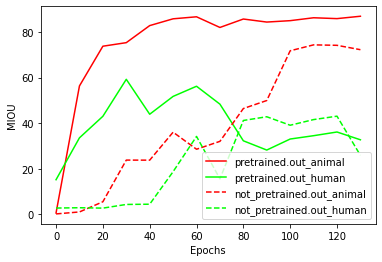

In [36]:
%matplotlib inline
def parse_val_performance(file_name):
    with open(file_name, 'r') as file:
        data = file.readlines()
    scores = defaultdict(list)
    for class_name in class_mappings.values():
        for line in data:
            if line.startswith(class_name):
                scores[class_name].append(float(line.replace(class_name, '').replace(' ','')))
    return scores
        
fig = plt.figure()
ax = fig.add_subplot(111)  
for file_name, linestyle in [['pretrained.out', 'solid'],['not_pretrained.out', 'dashed'] ]:
    scores = parse_val_performance(file_name)
    for class_idx, (k, v) in enumerate(scores.items()):
        name= f"{file_name}_{k}"
        color = [x/255. for x in colors[class_idx % len(colors)]]
        epochs_per_eval = tf_train_proto.evaluation_config.validation_period_during_training
        ax.plot([x * epochs_per_eval for x in range(len(v))], v ,color = color, linestyle = linestyle, label = name)
        
    ax.legend(loc="lower right")            
    ax.set_xlabel("Epochs")
    ax.set_ylabel("MIOU")    
fig.show()
plt.show()

In [37]:
!ls -lh $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned/weights

total 43M
-rw-r--r-- 1 root root 43M Mar 16 11:29 resnet18_detector.tlt


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Prune the trained model

* Note that this is just one of the compression techniques that nvidia-offers.
* Quantize aware training is explained in the original notebook if that is of interest. It should plug right in here.


<i>From the original nvidia notebook</i>:
* Usually, you just need to adjust `-pth` (threshold) for accuracy and model size trade off. Higher `pth` gives you smaller model (and thus higher inference speed) but worse accuracy. The threshold to use is dependent on the dataset. A pth value `5.2e-6` is just a start point. If the retrain accuracy is good, you can increase this value to get smaller models. Otherwise, lower this value to get better accuracy.*

* For some internal studies, we have noticed that a pth value of 0.01 is a good starting point for detectnet_v2 models.*

In [38]:
# Create an output directory if it doesn't exist.
PRUNED_MODEL_FILE_NAME = os.environ['PRUNED_MODEL_FILE_NAME'] = f"{MODEL_NAME}{NUM_LAYERS}_pruned"
!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_pruned
!tlt detectnet_v2 prune \
                  -m $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_unpruned/weights/$MODEL_FILE_NAME.tlt \
                  -o $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_pruned/$PRUNED_MODEL_FILE_NAME.tlt \
                  -eq union \
                  -pth 0.01 \
                  -k $KEY

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2021-03-16 11:49:23,764 [WARNING] tlt.components.docker_handler.docker_handler: 
Docker will run the commands as root. If you would like to retain your
local host permissions, please add the "user":"UID:GID" in the
DockerOptions portion of the ~/.tlt_mounts.json file. You can obtain your
users UID and GID by using the "id -u" and "id -g" commands on the
terminal.
Using TensorFlow backend.
Using TensorFlow backend.
2021-03-16 15:49:33,366 [INFO] modulus.pruning.pruning: Exploring graph for retainable indices
2021-03-16 15:49:34,102 [INFO] modulus.pruning.pruning: Pruning model and appending pruned nodes to new graph
2021-03-16 15:49:46,967 [INFO] iva.common.magnet_prune: Pruning ratio (pruned model / original model): 1.0
2021-03-16 11:49:48,783 [INFO] tlt.components.docker_handler.docker_handler: Stopping container.


In [39]:
!ls -rlt $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_pruned

total 43960
-rw-r--r-- 1 root root 45012648 Mar 16 11:49 resnet18_pruned.tlt


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


##### Retrain the pruned model
* Model needs to be re-trained to bring back accuracy after pruning
* Specify re-training specification with pretrained weights as pruned model.

From the original notebook (if you are:

*Note: For retraining, please set the `load_graph` option to `true` in the model_config 

In [40]:
#Configure Retraining params 
tf_train_proto = _Merge(os.path.join(LOCAL_ROOT, SPECS_DIR, BASIC_TRAIN_PROTO), experiment_pb2.Experiment())
tf_train_proto.model_config.pretrained_model_file = os.path.join(DOCKER_ROOT,EXPERIMENT_DIR, f"experiment_dir_pruned/{PRUNED_MODEL_FILE_NAME}.tlt")
tf_train_proto.training_config.num_epochs = RETRAIN_EPOCHS
tf_train_proto.model_config.load_graph = True # Required for retraining
with open(os.path.join(LOCAL_ROOT, SPECS_DIR, RETRAIN_PROTO), 'w') as file:
    file.write(str(tf_train_proto))

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [41]:
!cat $LOCAL_ROOT/$SPECS_DIR/$RETRAIN_PROTO

random_seed: 42
dataset_config {
  data_sources {
    tfrecords_path: "/workspace/tlt-experiments/data/tfrecords/kitti_trainval/*"
    image_directory_path: "/workspace/tlt-experiments/data/training"
  }
  image_extension: "jpg"
  target_class_mapping {
    key: "animal"
    value: "animal"
  }
  target_class_mapping {
    key: "human"
    value: "human"
  }
  validation_fold: 0
}
augmentation_config {
  preprocessing {
    output_image_width: 512
    output_image_height: 384
    min_bbox_width: 1.0
    min_bbox_height: 1.0
    output_image_channel: 3
  }
  spatial_augmentation {
    hflip_probability: 0.5
    zoom_min: 1.0
    zoom_max: 1.0
    translate_max_x: 8.0
    translate_max_y: 8.0
  }
  color_augmentation {
    hue_rotation_max: 25.0
    saturation_shift_max: 0.20000000298023224
    contrast_scale_max: 0.10000000149011612
    contrast_center: 0.5
  }
}
postprocessing_config {
  target_class_config {
    key: "animal"
    value {
      clustering_config {
        coverage_thre

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [42]:
# Retraining using the pruned model as pretrained weights 
!tlt detectnet_v2 train -e $DOCKER_ROOT/$SPECS_DIR/$RETRAIN_PROTO \
                        -r $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_retrain \
                        -k $KEY \
                        -n $PRUNED_MODEL_FILE_NAME \
                        --gpus $NUM_GPUS

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2021-03-16 11:50:00,224 [WARNING] tlt.components.docker_handler.docker_handler: 
Docker will run the commands as root. If you would like to retain your
local host permissions, please add the "user":"UID:GID" in the
DockerOptions portion of the ~/.tlt_mounts.json file. You can obtain your
users UID and GID by using the "id -u" and "id -g" commands on the
terminal.
Using TensorFlow backend.
Using TensorFlow backend.





2021-03-16 15:50:06,962 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/horovod/tensorflow/__init__.py:117: The name tf.global_variables is deprecated. Please use tf.compat.v1.global_variables instead.


2021-03-16 15:50:06,962 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/horovod/tensorflow/__init__.py:143: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

2021-03-16 15:50:07,955 [INFO] __main__: Loading experiment spec at /workspace/tlt-experiments/specs/detectnet_v2_retrain_resnet18_k

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 3, 384, 512)  0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 64, 192, 256) 9472        input_1[0][0]                    
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 64, 192, 256) 256         conv1[0][0]                      
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 64, 192, 256) 0           bn_conv1[0][0]                   
__________________________________________________________________________________________________
block_1a_c


2021-03-16 15:50:11,404 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/tensorflow_core/python/autograph/converters/directives.py:119: The name tf.set_random_seed is deprecated. Please use tf.compat.v1.set_random_seed instead.

2021-03-16 15:50:11,452 [WARNING] tensorflow: Entity <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7ff0b6d8c828>> could not be transformed and will be executed as-is. Please report this to the AutoGraph team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output. Cause: Unable to locate the source code of <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7ff0b6d8c828>>. Note that functions defined in certain environments, like the interactive Python shell do not expose their source code. If that is the case, you

2021-03-16 15:50:14,100 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Serial augmentation enabled = False
2021-03-16 15:50:14,100 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Pseudo sharding enabled = False
2021-03-16 15:50:14,100 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: Max Image Dimensions (all sources): (0, 0)
2021-03-16 15:50:14,100 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: number of cpus: 12, io threads: 24, compute threads: 12, buffered batches: 4
2021-03-16 15:50:14,101 [INFO] modulus.blocks.data_loaders.multi_source_loader.data_loader: total dataset size 111, number of sources: 1, batch size per gpu: 12, steps: 10
2021-03-16 15:50:14,110 [WARNING] tensorflow: Entity <bound method DriveNetTFRecordsParser.__call__ of <iva.detectnet_v2.dataloader.drivenet_dataloader.DriveNetTFRecordsParser object at 0x7ff0b6d8c8d0>> could not be transformed and will be executed as-is. Please report th

INFO:tensorflow:Graph was finalized.
2021-03-16 15:50:17,149 [INFO] tensorflow: Graph was finalized.
INFO:tensorflow:Running local_init_op.
2021-03-16 15:50:18,813 [INFO] tensorflow: Running local_init_op.
INFO:tensorflow:Done running local_init_op.
2021-03-16 15:50:19,380 [INFO] tensorflow: Done running local_init_op.
INFO:tensorflow:Saving checkpoints for step-0.
2021-03-16 15:50:25,774 [INFO] tensorflow: Saving checkpoints for step-0.
INFO:tensorflow:epoch = 0.0, loss = 0.0008283741, step = 0
2021-03-16 15:50:46,875 [INFO] tensorflow: epoch = 0.0, loss = 0.0008283741, step = 0
2021-03-16 15:50:46,878 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 0/80: loss: 0.00083 Time taken: 0:00:00 ETA: 0:00:00
2021-03-16 15:50:46,878 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 1.721
INFO:tensorflow:global_step/sec: 1.31637
2021-03-16 15:50:50,675 [INFO] tensorflow: global_step/sec: 1.31637
INFO:tensorflow:global_step/sec: 7.8

2021-03-16 15:51:07,944 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.806
INFO:tensorflow:global_step/sec: 7.7668
2021-03-16 15:51:08,072 [INFO] tensorflow: global_step/sec: 7.7668
INFO:tensorflow:global_step/sec: 7.72708
2021-03-16 15:51:08,719 [INFO] tensorflow: global_step/sec: 7.72708
INFO:tensorflow:epoch = 2.333333333333333, loss = 0.00034886383, step = 133 (5.177 sec)
2021-03-16 15:51:09,111 [INFO] tensorflow: epoch = 2.333333333333333, loss = 0.00034886383, step = 133 (5.177 sec)
INFO:tensorflow:global_step/sec: 7.71022
2021-03-16 15:51:09,368 [INFO] tensorflow: global_step/sec: 7.71022
INFO:tensorflow:global_step/sec: 7.77118
2021-03-16 15:51:10,011 [INFO] tensorflow: global_step/sec: 7.77118
INFO:tensorflow:global_step/sec: 7.79899
2021-03-16 15:51:10,652 [INFO] tensorflow: global_step/sec: 7.79899
2021-03-16 15:51:11,172 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.943
INFO:tensorflow:global_step/sec: 7.71678
2021-03-16 15:51:11,300 [

INFO:tensorflow:global_step/sec: 7.64811
2021-03-16 15:51:39,785 [INFO] tensorflow: global_step/sec: 7.64811
INFO:tensorflow:epoch = 6.5438596491228065, loss = 0.0003679447, step = 373 (5.192 sec)
2021-03-16 15:51:40,180 [INFO] tensorflow: epoch = 6.5438596491228065, loss = 0.0003679447, step = 373 (5.192 sec)
2021-03-16 15:51:40,310 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.202
INFO:tensorflow:global_step/sec: 7.66451
2021-03-16 15:51:40,437 [INFO] tensorflow: global_step/sec: 7.66451
INFO:tensorflow:global_step/sec: 7.72337
2021-03-16 15:51:41,084 [INFO] tensorflow: global_step/sec: 7.72337
INFO:tensorflow:global_step/sec: 7.7638
2021-03-16 15:51:41,728 [INFO] tensorflow: global_step/sec: 7.7638
INFO:tensorflow:global_step/sec: 7.8351
2021-03-16 15:51:42,367 [INFO] tensorflow: global_step/sec: 7.8351
INFO:tensorflow:global_step/sec: 7.74216
2021-03-16 15:51:43,012 [INFO] tensorflow: global_step/sec: 7.74216
2021-03-16 15:51:43,537 [INFO] /usr/local/lib/python3

INFO:tensorflow:global_step/sec: 7.73875
2021-03-16 15:52:15,925 [INFO] tensorflow: global_step/sec: 7.73875
INFO:tensorflow:global_step/sec: 7.76699
2021-03-16 15:52:16,568 [INFO] tensorflow: global_step/sec: 7.76699
2021-03-16 15:52:17,082 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.439
INFO:tensorflow:global_step/sec: 7.7668
2021-03-16 15:52:17,212 [INFO] tensorflow: global_step/sec: 7.7668
INFO:tensorflow:global_step/sec: 7.72082
2021-03-16 15:52:17,860 [INFO] tensorflow: global_step/sec: 7.72082
INFO:tensorflow:epoch = 10.701754385964911, loss = 0.00043383002, step = 610 (5.150 sec)
2021-03-16 15:52:18,505 [INFO] tensorflow: epoch = 10.701754385964911, loss = 0.00043383002, step = 610 (5.150 sec)
INFO:tensorflow:global_step/sec: 7.72729
2021-03-16 15:52:18,507 [INFO] tensorflow: global_step/sec: 7.72729
INFO:tensorflow:global_step/sec: 7.71275
2021-03-16 15:52:19,155 [INFO] tensorflow: global_step/sec: 7.71275
INFO:tensorflow:global_step/sec: 7.71779
2021-03-

INFO:tensorflow:global_step/sec: 7.69316
2021-03-16 15:52:47,602 [INFO] tensorflow: global_step/sec: 7.69316
INFO:tensorflow:global_step/sec: 7.75849
2021-03-16 15:52:48,247 [INFO] tensorflow: global_step/sec: 7.75849
INFO:tensorflow:global_step/sec: 7.69754
2021-03-16 15:52:48,896 [INFO] tensorflow: global_step/sec: 7.69754
2021-03-16 15:52:49,411 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.850
INFO:tensorflow:epoch = 14.912280701754385, loss = 0.00037303945, step = 850 (5.166 sec)
2021-03-16 15:52:49,542 [INFO] tensorflow: epoch = 14.912280701754385, loss = 0.00037303945, step = 850 (5.166 sec)
INFO:tensorflow:global_step/sec: 7.72747
2021-03-16 15:52:49,543 [INFO] tensorflow: global_step/sec: 7.72747
INFO:tensorflow:global_step/sec: 7.64621
2021-03-16 15:52:50,197 [INFO] tensorflow: global_step/sec: 7.64621
2021-03-16 15:52:50,199 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 15/80: loss: 0.00034 Time taken: 0

INFO:tensorflow:global_step/sec: 7.77971
2021-03-16 15:53:19,287 [INFO] tensorflow: global_step/sec: 7.77971
2021-03-16 15:53:19,684 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 19/80: loss: 0.00030 Time taken: 0:00:07.369081 ETA: 0:07:29.513971
INFO:tensorflow:global_step/sec: 7.64476
2021-03-16 15:53:19,941 [INFO] tensorflow: global_step/sec: 7.64476
INFO:tensorflow:epoch = 19.12280701754386, loss = 0.00032201316, step = 1090 (5.168 sec)
2021-03-16 15:53:20,584 [INFO] tensorflow: epoch = 19.12280701754386, loss = 0.00032201316, step = 1090 (5.168 sec)
INFO:tensorflow:global_step/sec: 7.75953
2021-03-16 15:53:20,585 [INFO] tensorflow: global_step/sec: 7.75953
INFO:tensorflow:global_step/sec: 7.65539
2021-03-16 15:53:21,238 [INFO] tensorflow: global_step/sec: 7.65539
2021-03-16 15:53:21,758 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.565
INFO:tensorflow:global_step/sec: 7.70725
2021-03-16 15:53:21,887 [INFO] ten

2021-03-16 15:53:52,700 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.035
INFO:tensorflow:epoch = 22.807017543859647, loss = 0.00029213115, step = 1300 (5.169 sec)
2021-03-16 15:53:52,830 [INFO] tensorflow: epoch = 22.807017543859647, loss = 0.00029213115, step = 1300 (5.169 sec)
INFO:tensorflow:global_step/sec: 7.69155
2021-03-16 15:53:52,831 [INFO] tensorflow: global_step/sec: 7.69155
INFO:tensorflow:global_step/sec: 7.53628
2021-03-16 15:53:53,495 [INFO] tensorflow: global_step/sec: 7.53628
INFO:tensorflow:global_step/sec: 7.69342
2021-03-16 15:53:54,145 [INFO] tensorflow: global_step/sec: 7.69342
2021-03-16 15:53:54,283 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 23/80: loss: 0.00040 Time taken: 0:00:07.392831 ETA: 0:07:01.391358
INFO:tensorflow:global_step/sec: 7.6805
2021-03-16 15:53:54,795 [INFO] tensorflow: global_step/sec: 7.6805
INFO:tensorflow:global_step/sec: 7.80501
2021-03-16 15:53:55,436 [INFO] ten

INFO:tensorflow:epoch = 27.01754385964912, loss = 0.00029284728, step = 1540 (5.167 sec)
2021-03-16 15:54:23,906 [INFO] tensorflow: epoch = 27.01754385964912, loss = 0.00029284728, step = 1540 (5.167 sec)
INFO:tensorflow:global_step/sec: 7.44834
2021-03-16 15:54:23,907 [INFO] tensorflow: global_step/sec: 7.44834
INFO:tensorflow:global_step/sec: 7.74725
2021-03-16 15:54:24,553 [INFO] tensorflow: global_step/sec: 7.74725
2021-03-16 15:54:25,072 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.689
INFO:tensorflow:global_step/sec: 7.72287
2021-03-16 15:54:25,200 [INFO] tensorflow: global_step/sec: 7.72287
INFO:tensorflow:global_step/sec: 7.73098
2021-03-16 15:54:25,847 [INFO] tensorflow: global_step/sec: 7.73098
INFO:tensorflow:global_step/sec: 7.79779
2021-03-16 15:54:26,488 [INFO] tensorflow: global_step/sec: 7.79779
INFO:tensorflow:global_step/sec: 7.72451
2021-03-16 15:54:27,135 [INFO] tensorflow: global_step/sec: 7.72451
INFO:tensorflow:global_step/sec: 7.65787
2021-0

INFO:tensorflow:global_step/sec: 7.69782
2021-03-16 15:54:56,565 [INFO] tensorflow: global_step/sec: 7.69782
INFO:tensorflow:global_step/sec: 7.73017
2021-03-16 15:54:57,212 [INFO] tensorflow: global_step/sec: 7.73017
INFO:tensorflow:global_step/sec: 7.77186
2021-03-16 15:54:57,855 [INFO] tensorflow: global_step/sec: 7.77186
2021-03-16 15:54:58,122 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 31/80: loss: 0.00030 Time taken: 0:00:07.375711 ETA: 0:06:01.409849
INFO:tensorflow:global_step/sec: 7.62892
2021-03-16 15:54:58,511 [INFO] tensorflow: global_step/sec: 7.62892
2021-03-16 15:54:59,034 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.296
INFO:tensorflow:global_step/sec: 7.65113
2021-03-16 15:54:59,164 [INFO] tensorflow: global_step/sec: 7.65113
INFO:tensorflow:global_step/sec: 7.70767
2021-03-16 15:54:59,813 [INFO] tensorflow: global_step/sec: 7.70767
INFO:tensorflow:global_step/sec: 7.73825
2021-03-16 15:55:00,4

2021-03-16 15:55:28,142 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.180
INFO:tensorflow:global_step/sec: 7.80839
2021-03-16 15:55:28,271 [INFO] tensorflow: global_step/sec: 7.80839
INFO:tensorflow:global_step/sec: 7.74127
2021-03-16 15:55:28,917 [INFO] tensorflow: global_step/sec: 7.74127
INFO:tensorflow:global_step/sec: 7.7885
2021-03-16 15:55:29,559 [INFO] tensorflow: global_step/sec: 7.7885
INFO:tensorflow:global_step/sec: 7.61477
2021-03-16 15:55:30,216 [INFO] tensorflow: global_step/sec: 7.61477
INFO:tensorflow:global_step/sec: 7.77744
2021-03-16 15:55:30,859 [INFO] tensorflow: global_step/sec: 7.77744
2021-03-16 15:55:31,371 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.920
INFO:tensorflow:global_step/sec: 7.76566
2021-03-16 15:55:31,502 [INFO] tensorflow: global_step/sec: 7.76566
INFO:tensorflow:epoch = 35.614035087719294, loss = 0.00025355088, step = 2030 (5.169 sec)
2021-03-16 15:55:32,153 [INFO] tensorflow: epoch = 35.614035087719294,

INFO:tensorflow:global_step/sec: 7.79775
2021-03-16 15:55:59,964 [INFO] tensorflow: global_step/sec: 7.79775
2021-03-16 15:56:00,484 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.947
INFO:tensorflow:global_step/sec: 7.67498
2021-03-16 15:56:00,615 [INFO] tensorflow: global_step/sec: 7.67498
INFO:tensorflow:global_step/sec: 7.67536
2021-03-16 15:56:01,267 [INFO] tensorflow: global_step/sec: 7.67536
INFO:tensorflow:global_step/sec: 7.70636
2021-03-16 15:56:01,916 [INFO] tensorflow: global_step/sec: 7.70636
INFO:tensorflow:global_step/sec: 7.72902
2021-03-16 15:56:02,563 [INFO] tensorflow: global_step/sec: 7.72902
INFO:tensorflow:epoch = 39.82456140350877, loss = 0.00025793086, step = 2270 (5.181 sec)
2021-03-16 15:56:03,210 [INFO] tensorflow: epoch = 39.82456140350877, loss = 0.00025793086, step = 2270 (5.181 sec)
INFO:tensorflow:global_step/sec: 7.70194
2021-03-16 15:56:03,212 [INFO] tensorflow: global_step/sec: 7.70194
2021-03-16 15:56:03,724 [INFO] modulus.hooks.sa

INFO:tensorflow:global_step/sec: 7.76307
2021-03-16 15:56:33,391 [INFO] tensorflow: global_step/sec: 7.76307
INFO:tensorflow:global_step/sec: 7.74489
2021-03-16 15:56:34,037 [INFO] tensorflow: global_step/sec: 7.74489
2021-03-16 15:56:34,552 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.940
INFO:tensorflow:global_step/sec: 7.77498
2021-03-16 15:56:34,680 [INFO] tensorflow: global_step/sec: 7.77498
INFO:tensorflow:epoch = 43.50877192982456, loss = 0.00027232635, step = 2480 (5.156 sec)
2021-03-16 15:56:35,320 [INFO] tensorflow: epoch = 43.50877192982456, loss = 0.00027232635, step = 2480 (5.156 sec)
INFO:tensorflow:global_step/sec: 7.80115
2021-03-16 15:56:35,321 [INFO] tensorflow: global_step/sec: 7.80115
INFO:tensorflow:global_step/sec: 7.76203
2021-03-16 15:56:35,965 [INFO] tensorflow: global_step/sec: 7.76203
INFO:tensorflow:global_step/sec: 7.7446
2021-03-16 15:56:36,611 [INFO] tensorflow: global_step/sec: 7.7446
INFO:tensorflow:global_step/sec: 7.75815
2021-03-

INFO:tensorflow:global_step/sec: 7.59434
2021-03-16 15:57:05,121 [INFO] tensorflow: global_step/sec: 7.59434
INFO:tensorflow:global_step/sec: 7.77153
2021-03-16 15:57:05,765 [INFO] tensorflow: global_step/sec: 7.77153
INFO:tensorflow:epoch = 47.719298245614034, loss = 0.00024212788, step = 2720 (5.180 sec)
2021-03-16 15:57:06,415 [INFO] tensorflow: epoch = 47.719298245614034, loss = 0.00024212788, step = 2720 (5.180 sec)
INFO:tensorflow:global_step/sec: 7.67423
2021-03-16 15:57:06,416 [INFO] tensorflow: global_step/sec: 7.67423
2021-03-16 15:57:06,930 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.483
INFO:tensorflow:global_step/sec: 7.76554
2021-03-16 15:57:07,060 [INFO] tensorflow: global_step/sec: 7.76554
INFO:tensorflow:global_step/sec: 7.75164
2021-03-16 15:57:07,705 [INFO] tensorflow: global_step/sec: 7.75164
INFO:tensorflow:global_step/sec: 7.77756
2021-03-16 15:57:08,348 [INFO] tensorflow: global_step/sec: 7.77756
2021-03-16 15:57:08,486 [INFO] /usr/local/lib

2021-03-16 15:57:37,728 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.543
INFO:tensorflow:global_step/sec: 7.78217
2021-03-16 15:57:37,856 [INFO] tensorflow: global_step/sec: 7.78217
INFO:tensorflow:epoch = 51.40350877192982, loss = 0.00022939534, step = 2930 (5.171 sec)
2021-03-16 15:57:38,495 [INFO] tensorflow: epoch = 51.40350877192982, loss = 0.00022939534, step = 2930 (5.171 sec)
INFO:tensorflow:global_step/sec: 7.81784
2021-03-16 15:57:38,496 [INFO] tensorflow: global_step/sec: 7.81784
INFO:tensorflow:global_step/sec: 7.76173
2021-03-16 15:57:39,140 [INFO] tensorflow: global_step/sec: 7.76173
INFO:tensorflow:global_step/sec: 7.71758
2021-03-16 15:57:39,788 [INFO] tensorflow: global_step/sec: 7.71758
INFO:tensorflow:global_step/sec: 7.72029
2021-03-16 15:57:40,436 [INFO] tensorflow: global_step/sec: 7.72029
2021-03-16 15:57:40,954 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.012
INFO:tensorflow:global_step/sec: 7.71108
2021-03-16 15:57:41,0

INFO:tensorflow:epoch = 55.614035087719294, loss = 0.00022546902, step = 3170 (5.169 sec)
2021-03-16 15:58:09,516 [INFO] tensorflow: epoch = 55.614035087719294, loss = 0.00022546902, step = 3170 (5.169 sec)
INFO:tensorflow:global_step/sec: 7.77412
2021-03-16 15:58:09,517 [INFO] tensorflow: global_step/sec: 7.77412
2021-03-16 15:58:10,027 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.085
INFO:tensorflow:global_step/sec: 7.7962
2021-03-16 15:58:10,159 [INFO] tensorflow: global_step/sec: 7.7962
INFO:tensorflow:global_step/sec: 7.74639
2021-03-16 15:58:10,804 [INFO] tensorflow: global_step/sec: 7.74639
INFO:tensorflow:global_step/sec: 7.77052
2021-03-16 15:58:11,448 [INFO] tensorflow: global_step/sec: 7.77052
INFO:tensorflow:global_step/sec: 7.73267
2021-03-16 15:58:12,094 [INFO] tensorflow: global_step/sec: 7.73267
2021-03-16 15:58:12,364 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 56/80: loss: 0.00025 Time taken: 0

INFO:tensorflow:global_step/sec: 7.72177
2021-03-16 15:58:41,222 [INFO] tensorflow: global_step/sec: 7.72177
INFO:tensorflow:Saving checkpoints for step-3420.
2021-03-16 15:58:41,739 [INFO] tensorflow: Saving checkpoints for step-3420.
2021-03-16 15:58:42,322 [WARNING] tensorflow: Ignoring: /tmp/tmpvsj83ozn; No such file or directory
2021-03-16 15:58:45,692 [INFO] iva.detectnet_v2.evaluation.evaluation: step 0 / 9, 0.00s/step
Matching predictions to ground truth, class 2/2.: 100%|█| 49/49 [00:00<00:00, 18171.61it/s]
Epoch 60/80

Validation cost: 0.000133
Mean average_precision (in %): 68.0663

class name      average precision (in %)
------------  --------------------------
animal                           84.0247
human                            52.1079

Median Inference Time: 0.006145
INFO:tensorflow:epoch = 60.0, loss = 0.00017147693, step = 3420 (6.187 sec)
2021-03-16 15:58:46,760 [INFO] tensorflow: epoch = 60.0, loss = 0.00017147693, step = 3420 (6.187 sec)
INFO:tensorflow:global_

INFO:tensorflow:global_step/sec: 7.71625
2021-03-16 15:59:13,300 [INFO] tensorflow: global_step/sec: 7.71625
INFO:tensorflow:global_step/sec: 7.76019
2021-03-16 15:59:13,945 [INFO] tensorflow: global_step/sec: 7.76019
INFO:tensorflow:global_step/sec: 7.66826
2021-03-16 15:59:14,597 [INFO] tensorflow: global_step/sec: 7.66826
INFO:tensorflow:global_step/sec: 7.77094
2021-03-16 15:59:15,240 [INFO] tensorflow: global_step/sec: 7.77094
INFO:tensorflow:global_step/sec: 7.71762
2021-03-16 15:59:15,888 [INFO] tensorflow: global_step/sec: 7.71762
2021-03-16 15:59:16,282 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 64/80: loss: 0.00016 Time taken: 0:00:07.377944 ETA: 0:01:58.047108
2021-03-16 15:59:16,414 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.514
INFO:tensorflow:global_step/sec: 7.63091
2021-03-16 15:59:16,543 [INFO] tensorflow: global_step/sec: 7.63091
INFO:tensorflow:global_step/sec: 7.71774
2021-03-16 15:59:17,1

2021-03-16 15:59:45,488 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.045
INFO:tensorflow:global_step/sec: 7.77228
2021-03-16 15:59:45,618 [INFO] tensorflow: global_step/sec: 7.77228
2021-03-16 15:59:45,760 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 68/80: loss: 0.00015 Time taken: 0:00:07.377301 ETA: 0:01:28.527617
INFO:tensorflow:global_step/sec: 7.65324
2021-03-16 15:59:46,271 [INFO] tensorflow: global_step/sec: 7.65324
INFO:tensorflow:global_step/sec: 7.73114
2021-03-16 15:59:46,918 [INFO] tensorflow: global_step/sec: 7.73114
INFO:tensorflow:global_step/sec: 7.79876
2021-03-16 15:59:47,559 [INFO] tensorflow: global_step/sec: 7.79876
INFO:tensorflow:global_step/sec: 7.75078
2021-03-16 15:59:48,204 [INFO] tensorflow: global_step/sec: 7.75078
2021-03-16 15:59:48,719 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.871
INFO:tensorflow:epoch = 68.42105263157895, loss = 0.00015706323, step = 3900 

INFO:tensorflow:global_step/sec: 7.80391
2021-03-16 16:00:17,575 [INFO] tensorflow: global_step/sec: 7.80391
INFO:tensorflow:global_step/sec: 7.73847
2021-03-16 16:00:18,221 [INFO] tensorflow: global_step/sec: 7.73847
INFO:tensorflow:global_step/sec: 7.7957
2021-03-16 16:00:18,862 [INFO] tensorflow: global_step/sec: 7.7957
2021-03-16 16:00:19,375 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 93.169
INFO:tensorflow:global_step/sec: 7.79659
2021-03-16 16:00:19,504 [INFO] tensorflow: global_step/sec: 7.79659
2021-03-16 16:00:20,024 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 72/80: loss: 0.00015 Time taken: 0:00:07.356012 ETA: 0:00:58.848099
INFO:tensorflow:global_step/sec: 7.70363
2021-03-16 16:00:20,153 [INFO] tensorflow: global_step/sec: 7.70363
INFO:tensorflow:epoch = 72.10526315789474, loss = 0.00016038405, step = 4110 (5.156 sec)
2021-03-16 16:00:20,796 [INFO] tensorflow: epoch = 72.10526315789474, loss = 0.00016

INFO:tensorflow:global_step/sec: 7.73189
2021-03-16 16:00:49,272 [INFO] tensorflow: global_step/sec: 7.73189
2021-03-16 16:00:49,534 [INFO] /usr/local/lib/python3.6/dist-packages/modulus/hooks/task_progress_monitor_hook.pyc: Epoch 76/80: loss: 0.00015 Time taken: 0:00:07.353195 ETA: 0:00:29.412779
INFO:tensorflow:global_step/sec: 7.70858
2021-03-16 16:00:49,920 [INFO] tensorflow: global_step/sec: 7.70858
INFO:tensorflow:global_step/sec: 7.71553
2021-03-16 16:00:50,568 [INFO] tensorflow: global_step/sec: 7.71553
INFO:tensorflow:global_step/sec: 7.77612
2021-03-16 16:00:51,211 [INFO] tensorflow: global_step/sec: 7.77612
2021-03-16 16:00:51,725 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.909
INFO:tensorflow:epoch = 76.3157894736842, loss = 0.00014357906, step = 4350 (5.153 sec)
2021-03-16 16:00:51,855 [INFO] tensorflow: epoch = 76.3157894736842, loss = 0.00014357906, step = 4350 (5.153 sec)
INFO:tensorflow:global_step/sec: 7.74966
2021-03-16 16:00:51,856 [INFO] tenso

Matching predictions to ground truth, class 2/2.: 100%|█| 23/23 [00:00<00:00, 13928.53it/s]
Epoch 80/80

Validation cost: 0.000121
Mean average_precision (in %): 72.3497

class name      average precision (in %)
------------  --------------------------
animal                           86.8971
human                            57.8022

Median Inference Time: 0.006268

2021-03-16 16:01:24,599 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:95: The name tf.reset_default_graph is deprecated. Please use tf.compat.v1.reset_default_graph instead.


2021-03-16 16:01:24,599 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:98: The name tf.placeholder_with_default is deprecated. Please use tf.compat.v1.placeholder_with_default instead.

2021-03-16 16:01:24,602 [INFO] modulus.hooks.sample_counter_hook: Train Samples / sec: 92.807
Time taken to run __main__:main: 0:11:17.812084.
2021-03-16 12:0

In [43]:
# Listing the newly retrained model.
!ls -rlt $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_retrain/weights

total 43960
-rw-r--r-- 1 root root 45012648 Mar 16 12:01 resnet18_pruned.tlt


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Visualize inferences


#### Configure inference params

In [44]:

tf_infer_proto = _Merge(os.path.join(LOCAL_ROOT, SPECS_DIR, TLT_INFERENCE_PROTO), inference_pb2.Inference())
tf_infer_proto.inferencer_config.ClearField("target_classes")
tf_infer_proto.bbox_handler_config.ClearField("classwise_bbox_handler_config")
#We need to set a few things here...


if len(colors) < len(class_mappings):
    print("Not enough colors to represent classes. Colors will repeat")
    
for idx, value in enumerate(set(class_mappings.values())):
    tf_infer_proto.inferencer_config.target_classes.append(value)

    for k,v in default_postprocessing_params.items():
        setattr(tf_infer_proto.bbox_handler_config.classwise_bbox_handler_config[value].clustering_config, k, v)
        tf_infer_proto.bbox_handler_config.classwise_bbox_handler_config[value].output_map = value
        tf_infer_proto.bbox_handler_config.classwise_bbox_handler_config[value].confidence_model = "aggregate_cov"        
        for c_idx, c in enumerate(['R', 'G', 'B']):
            setattr(tf_infer_proto.bbox_handler_config.classwise_bbox_handler_config[value].bbox_color, c, colors[idx%len(colors)][c_idx])
        
tf_infer_proto.inferencer_config.image_width = IMAGE_W
tf_infer_proto.inferencer_config.image_height = IMAGE_H

#Pick whichever

NON_PRUNED_WEIGHTS = os.path.join(DOCKER_ROOT, EXPERIMENT_DIR, f"experiment_dir_unpruned/weights/{MODEL_FILE_NAME}.tlt")
PRUNED_WEIGHTS = os.path.join(DOCKER_ROOT, EXPERIMENT_DIR,f"experiment_dir_retrain/weights/{PRUNED_MODEL_FILE_NAME}.tlt")
tf_infer_proto.inferencer_config.tlt_config.model = PRUNED_WEIGHTS

with open(os.path.join(LOCAL_ROOT, SPECS_DIR, TLT_INFERENCE_PROTO), 'w') as file:
    file.write(str(tf_infer_proto))

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [45]:
!cat $LOCAL_ROOT/$SPECS_DIR/$TLT_INFERENCE_PROTO

inferencer_config {
  tlt_config {
    model: "/workspace/tlt-experiments/detectnet_v2/experiment_dir_retrain/weights/resnet18_pruned.tlt"
  }
  batch_size: 16
  image_height: 384
  image_width: 512
  image_channels: 3
  target_classes: "animal"
  target_classes: "human"
}
bbox_handler_config {
  kitti_dump: true
  overlay_linewidth: 2
  classwise_bbox_handler_config {
    key: "animal"
    value {
      clustering_config {
        coverage_threshold: 0.004999999888241291
        minimum_bounding_box_height: 10
        dbscan_eps: 0.20000000298023224
        dbscan_min_samples: 0.05000000074505806
        dbscan_confidence_threshold: 0.8999999761581421
      }
      confidence_model: "aggregate_cov"
      output_map: "animal"
      bbox_color {
        R: 255
      }
    }
  }
  classwise_bbox_handler_config {
    key: "human"
    value {
      clustering_config {
        coverage_threshold: 0.004999999888241291
        minimum_bounding_box_height: 10
        dbscan_eps: 0.200000002980

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [46]:
!ls detectnet_v2/experiment_dir_unpruned/weights/

resnet18_detector.tlt


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [47]:
!tlt detectnet_v2 inference -e $DOCKER_ROOT/$SPECS_DIR/$TLT_INFERENCE_PROTO \
                            -o $DOCKER_ROOT/$EXPERIMENT_DIR/tlt_infer_testing \
                            -i $DOCKER_ROOT/$TESTING_DIR/$IMAGE_DIR \
                            -k $KEY

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2021-03-16 12:01:38,597 [WARNING] tlt.components.docker_handler.docker_handler: 
Docker will run the commands as root. If you would like to retain your
local host permissions, please add the "user":"UID:GID" in the
DockerOptions portion of the ~/.tlt_mounts.json file. You can obtain your
users UID and GID by using the "id -u" and "id -g" commands on the
terminal.
Using TensorFlow backend.
Using TensorFlow backend.
2021-03-16 16:01:45,539 [INFO] __main__: Creating output inference directory
2021-03-16 16:01:45,539 [INFO] __main__: Overlain images will be saved in the output path.
2021-03-16 16:01:45,539 [INFO] iva.detectnet_v2.inferencer.build_inferencer: Constructing inferencer

2021-03-16 16:01:45,540 [WARNING] tensorflow: From /home/vpraveen/.cache/dazel/_dazel_vpraveen/216c8b41e526c3295d3b802489ac2034/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_wheel.runfiles/ai_infra/iva/detectnet_v2/inferencer/tlt_inferencer.py:83: The name tf.ConfigProto is deprecated. 

In [48]:
# Simple grid visualizer
%matplotlib inline

valid_image_ext = ['.jpg', '.png', '.jpeg', '.ppm']

def visualize_inference_dir(image_dir, num_cols=4, num_images=10):
    output_path = os.path.join(LOCAL_ROOT,EXPERIMENT_DIR ,image_dir)
    num_rows = int(ceil(float(num_images) / float(num_cols)))
    f, axarr = plt.subplots(num_rows, num_cols, figsize=[80,30])
    f.tight_layout()
    a = [os.path.join(output_path, image) for image in os.listdir(output_path) 
         if os.path.splitext(image)[1].lower() in valid_image_ext]
    for idx, img_path in enumerate(a[:num_images]):
        col_id = idx % num_cols
        row_id = idx // num_cols
        img = plt.imread(img_path)
        axarr[row_id, col_id].imshow(img) 

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


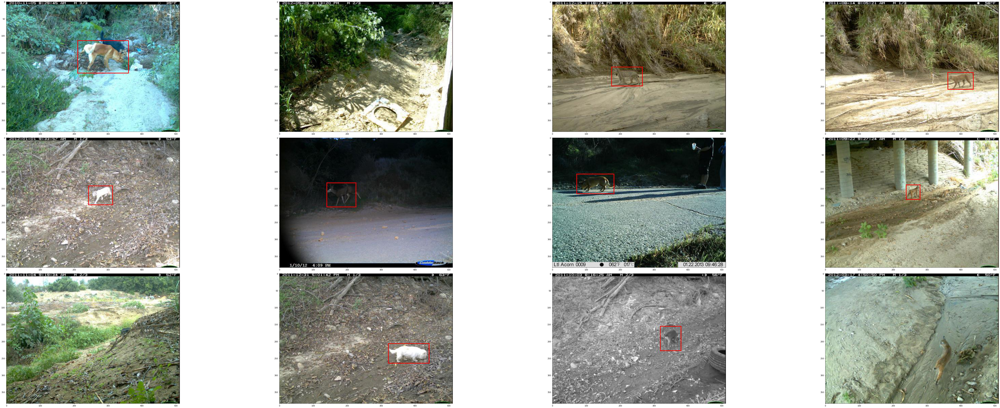

In [49]:
# Visualizing the first 12 images.
OUTPUT_PATH = 'tlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 
IMAGES = 12
visualize_inference_dir(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

## Model Export

#### TLT export

In [50]:
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_final
# Removing a pre-existing copy of the etlt if there has been any.

output_file=os.path.join(LOCAL_ROOT, EXPERIMENT_DIR,
                         f"experiment_dir_final/{MODEL_NAME}{NUM_LAYERS}_detector.etlt")
if os.path.exists(output_file):
    os.system("rm {}".format(output_file))
    
!tlt detectnet_v2 export \
                  -m $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_retrain/weights/$PRUNED_MODEL_FILE_NAME.tlt \
                  -o $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_final/$PRUNED_MODEL_FILE_NAME.etlt \
                  -k $KEY

mkdir: cannot create directory ‘/experiment_dir_final’: Permission denied


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2021-03-16 12:02:37,049 [WARNING] tlt.components.docker_handler.docker_handler: 
Docker will run the commands as root. If you would like to retain your
local host permissions, please add the "user":"UID:GID" in the
DockerOptions portion of the ~/.tlt_mounts.json file. You can obtain your
users UID and GID by using the "id -u" and "id -g" commands on the
terminal.
Using TensorFlow backend.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '
NOTE: UFF has been tested with TensorFlow 1.14.0.
DEBUG [/usr/local/lib/python3.6/dist-packages/uff/converters/tensorflow/converter.py:96] Marking ['output_cov/Sigmoid', 'output_bbox/BiasAdd'] as outputs
2021-03-16 12:03:21,970 [INFO] tlt.components.docker_handler.docker_handler: Stopping container.


In [51]:
print('Exported model:')
print('------------')
!ls -lh $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_final

Exported model:
------------
total 43M
-rw-r--r-- 1 root root 43M Mar 16 12:02 resnet18_pruned.etlt


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


#### Generate TensorRT engine 

In [52]:

!tlt tlt-converter $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_final/$PRUNED_MODEL_FILE_NAME.etlt \
                   -k $KEY \
                   -c $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_final/calibration.bin \
                   -o output_cov/Sigmoid,output_bbox/BiasAdd \
                   -d 3,$IMAGE_H,$IMAGE_W \
                   -i nchw \
                   -m 32 \
                   -t fp32 \
                   -e $DOCKER_ROOT/$EXPERIMENT_DIR/experiment_dir_final/$PRUNED_MODEL_FILE_NAME.trt \
                   -b 4 \
                   -w 8737418240

#[fp16, int8, fp32] #Note the above fails silently

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2021-03-16 12:03:33,060 [WARNING] tlt.components.docker_handler.docker_handler: 
Docker will run the commands as root. If you would like to retain your
local host permissions, please add the "user":"UID:GID" in the
DockerOptions portion of the ~/.tlt_mounts.json file. You can obtain your
users UID and GID by using the "id -u" and "id -g" commands on the
terminal.
[INFO] Some tactics do not have sufficient workspace memory to run. Increasing workspace size may increase performance, please check verbose output.
[INFO] Detected 1 inputs and 2 output network tensors.
2021-03-16 12:04:03,591 [INFO] tlt.components.docker_handler.docker_handler: Stopping container.


In [53]:
!ls detectnet_v2/experiment_dir_final/

resnet18_pruned.etlt  resnet18_pruned.trt


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### A. Inference using TensorRT engine <a class="anchor" id="head-11-1"></a>

In [54]:
tf_infer_proto.inferencer_config.ClearField("tlt_config")
TRT_MODEL = os.path.join(DOCKER_ROOT, EXPERIMENT_DIR,f"experiment_dir_final/{PRUNED_MODEL_FILE_NAME}.trt")
tf_infer_proto.inferencer_config.tensorrt_config.trt_engine =TRT_MODEL
with open(os.path.join(LOCAL_ROOT, SPECS_DIR, TRT_INFERENCE_PROTO), 'w') as file:
    file.write(str(tf_infer_proto))

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [55]:
!cat $LOCAL_ROOT/$SPECS_DIR/$TRT_INFERENCE_PROTO
!ls -lrt $LOCAL_ROOT/detectnet_v2/experiment_dir_final/

inferencer_config {
  tensorrt_config {
    trt_engine: "/workspace/tlt-experiments/detectnet_v2/experiment_dir_final/resnet18_pruned.trt"
  }
  batch_size: 16
  image_height: 384
  image_width: 512
  image_channels: 3
  target_classes: "animal"
  target_classes: "human"
}
bbox_handler_config {
  kitti_dump: true
  overlay_linewidth: 2
  classwise_bbox_handler_config {
    key: "animal"
    value {
      clustering_config {
        coverage_threshold: 0.004999999888241291
        minimum_bounding_box_height: 10
        dbscan_eps: 0.20000000298023224
        dbscan_min_samples: 0.05000000074505806
        dbscan_confidence_threshold: 0.8999999761581421
      }
      confidence_model: "aggregate_cov"
      output_map: "animal"
      bbox_color {
        R: 255
      }
    }
  }
  classwise_bbox_handler_config {
    key: "human"
    value {
      clustering_config {
        coverage_threshold: 0.004999999888241291
        minimum_bounding_box_height: 10
        dbscan_eps: 0.200000002980

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


total 145156
-rw-r--r-- 1 root root  44874341 Mar 16 12:02 resnet18_pruned.etlt
-rw-r--r-- 1 root root 103763532 Mar 16 12:04 resnet18_pruned.trt


In [56]:
!tlt detectnet_v2 inference -e $DOCKER_ROOT/$SPECS_DIR/$TRT_INFERENCE_PROTO \
                            -o $DOCKER_ROOT/$EXPERIMENT_DIR/etlt_infer_testing \
                            -i $DOCKER_ROOT/$TESTING_DIR/$IMAGE_DIR \
                            -k $KEY


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2021-03-16 12:04:15,164 [WARNING] tlt.components.docker_handler.docker_handler: 
Docker will run the commands as root. If you would like to retain your
local host permissions, please add the "user":"UID:GID" in the
DockerOptions portion of the ~/.tlt_mounts.json file. You can obtain your
users UID and GID by using the "id -u" and "id -g" commands on the
terminal.
Using TensorFlow backend.
Using TensorFlow backend.
2021-03-16 16:04:22,167 [INFO] __main__: Creating output inference directory
2021-03-16 16:04:22,168 [INFO] __main__: Overlain images will be saved in the output path.
2021-03-16 16:04:22,168 [INFO] iva.detectnet_v2.inferencer.build_inferencer: Constructing inferencer
2021-03-16 16:04:33,094 [INFO] iva.detectnet_v2.inferencer.trt_inferencer: Reading from engine file at: /workspace/tlt-experiments/detectnet_v2/experiment_dir_final/resnet18_pruned.trt
2021-03-16 16:04:35,269 [INFO] __main__: Initialized model
2021-03-16 16:04:35,270 [INFO] __main__: Commencing inference
100%|██

In [57]:
!ls $LOCAL_ROOT/$EXPERIMENT_DIR/etlt_infer_testing

images_annotated  labels


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


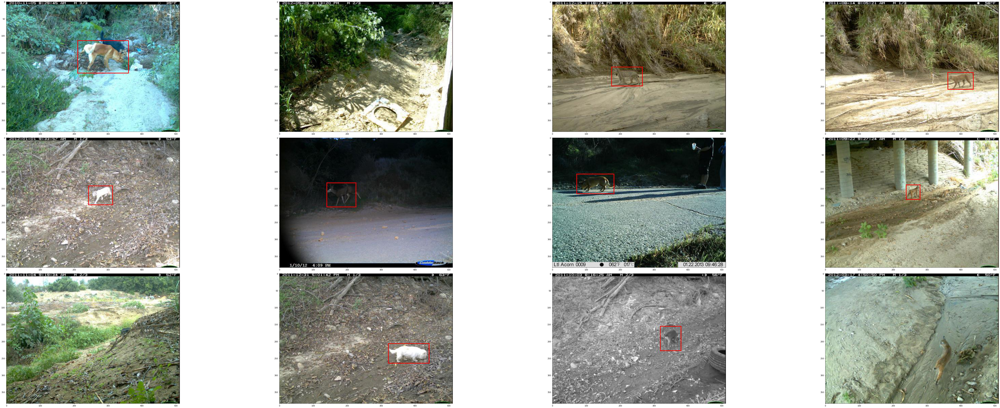

In [58]:
OUTPUT_PATH = 'etlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 # number of columns in the visualizer grid.
IMAGES = 12 # number of images to visualize.
visualize_inference_dir(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

### Deploy Model to NVIDIA Triton Inference Server

* Once the model has been converted into a trt engine, creating a production grade deployment is as easy as the following

In [60]:
#Move the file to a directory for deployment

!mkdir -p $LOCAL_ROOT/$EXPERIMENT_DIR/deploy/$PRUNED_MODEL_FILE_NAME/1
!mv $LOCAL_ROOT/$EXPERIMENT_DIR/experiment_dir_final/$PRUNED_MODEL_FILE_NAME.trt $LOCAL_ROOT/$EXPERIMENT_DIR/deploy/$PRUNED_MODEL_FILE_NAME/1/

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [61]:

os.system(
    "nvidia-docker run \
       --gpus=1 \
       --rm \
       --shm-size=1g \
       --ulimit memlock=-1 \
       --ulimit stack=67108864 \
       -p8000:8000 \
       -p8001:8001 \
       -p8002:8002 \
       -v$LOCAL_ROOT/$EXPERIMENT_DIR/deploy:/models nvcr.io/nvidia/tritonserver:20.11-py3 \
       tritonserver \
       --model-repository=/models \
       --strict-model-config=false &"
)

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0

#### Client wrapper

In [62]:
#Thanks - https://medium.com/nvidia-ai/how-to-deploy-almost-any-hugging-face-model-on-nvidia-triton-inference-server-with-an-8ee7ec0e6fc4"

def print_model_meta(model_name=PRUNED_MODEL_FILE_NAME, url='0.0.0.0:8000', model_version='1'):
    model_metadata = triton_client.get_model_metadata(model_name=model_name, model_version=model_version)
    model_config = triton_client.get_model_config(model_name=model_name, model_version=model_version),
    print(model_config)
    print(model_metadata)
    
def preprocess(img):
    if len(img.shape) == 3:
        img = np.expand_dims(img, axis = 0)
    img = img / 255. 
    return img.astype(np.float32).transpose((0,3,1,2))
    

def run_inference(img, model_name=PRUNED_MODEL_FILE_NAME, url='0.0.0.0:8000', model_version='1'):
    img = preprocess(img)
    triton_client = tritonhttpclient.InferenceServerClient(url=url, verbose=False)
    input0 = tritonhttpclient.InferInput("input_1", (1, 3,IMAGE_H,IMAGE_W), 'FP32')
    input0.set_data_from_numpy(img, binary_data=False)
    output0 = tritonhttpclient.InferRequestedOutput("output_bbox/BiasAdd",  binary_data=False)
    output1 = tritonhttpclient.InferRequestedOutput("output_cov/Sigmoid",  binary_data=False)
    response = triton_client.infer(model_name,model_version=model_version, inputs=[input0], outputs=[output0, output1])
    covs = response.as_numpy("output_cov/Sigmoid")
    boxes = response.as_numpy("output_bbox/BiasAdd") 
    return covs, boxes


/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


#### Postprocessing

In [63]:
#Thanks - carlos.alvarez https://forums.developer.nvidia.com/t/run-peoplenet-with-tensorrt/128000/21

def applyBoxNorm(o1, o2, o3, o4, x, y, grid_centers_w, grid_centers_h, box_norm):
    o1 = (o1 - grid_centers_w[x]) * -box_norm
    o2 = (o2 - grid_centers_h[y]) * -box_norm
    o3 = (o3 + grid_centers_w[x]) * box_norm
    o4 = (o4 + grid_centers_h[y]) * box_norm
    return o1, o2, o3, o4


def postprocess(outputs, min_confidence, analysis_classes, model_h, model_w,stride = 16, box_norm = 35, wh_format=True):
    grid_h = int(model_h / stride)
    grid_w = int(model_w / stride)
    grid_size = grid_h * grid_w

    grid_centers_w = []
    grid_centers_h = []

    for i in range(grid_h):
        value = (i * stride + 0.5) / box_norm
        grid_centers_h.append(value)

    for i in range(grid_w):
        value = (i * stride + 0.5) / box_norm
        grid_centers_w.append(value)
        
        
    bbs = []
    class_ids = []
    scores = []
    for c in analysis_classes:


        x1_idx = c * 4 * grid_size
        y1_idx = x1_idx + grid_size
        x2_idx = y1_idx + grid_size
        y2_idx = x2_idx + grid_size

        boxes = outputs[0]
        for h in range(grid_h):
            for w in range(grid_w):
                i = w + h * grid_w
                score = outputs[1][c * grid_size + i]
                if score >= min_confidence:
                    o1 = boxes[x1_idx + w + h * grid_w]
                    o2 = boxes[y1_idx + w + h * grid_w]
                    o3 = boxes[x2_idx + w + h * grid_w]
                    o4 = boxes[y2_idx + w + h * grid_w]

                    o1, o2, o3, o4 = applyBoxNorm(o1, o2, o3, o4, w, h, grid_centers_w, grid_centers_h, box_norm)

                    xmin = int(o1)
                    ymin = int(o2)
                    xmax = int(o3)
                    ymax = int(o4)
                    if wh_format:
                        bbs.append([xmin, ymin, xmax - xmin, ymax - ymin])
                    else:
                        bbs.append([xmin, ymin, xmax, ymax])
                    class_ids.append(c)
                    scores.append(float(score))
    return bbs, class_ids, scores


def predict(image, model_h, model_w, threshold = 0.1):
    image = cv2.resize(image, (model_w, model_h))
    keepCount_out, detection_out  = run_inference(image)
    num_classes = detection_out.shape[0]
    detection_out = detection_out.reshape(-1)
    keepCount_out = keepCount_out.reshape(-1)
    bboxes, class_ids, scores = postprocess(
        [detection_out, keepCount_out], 
        threshold, 
        list(range(num_classes)), 
        model_h, model_w
    )
    indices = cv2.dnn.NMSBoxes(bboxes, scores, threshold, 0.5)
    inferences = []
    for idx in indices:
        inferences.append({
            'bbox' : bboxes[int(idx)],
            'class_id' : class_ids[int(idx)]
        })
    return inferences

def visualize_inference(image, inferences, model_h, model_w):
    image = cv2.resize(image.copy(), (model_w, model_h))
    for inference in inferences:
        xmin, ymin, w, h = inference['bbox']
        class_id = inference['class_id']
        color = [255, 0, 0] if class_id else [0, 0, 255]
        cv2.rectangle(image, (xmin, ymin), (xmin + w, ymin + h), color, 2)
    plt.imshow(image)
    plt.show()

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Make a request to the deployed model!
<b> Make sure you wait for the triton server to start!</b>
* It will be ready when you see Start <service> at <ip>:port>

/home/matt/.local/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


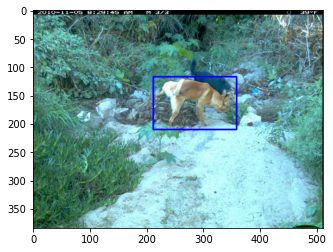

In [65]:
fs = [os.path.join(TEST_IMAGE_DIR, f) for f in os.listdir(TEST_IMAGE_DIR)]
image = cv2.imread(fs[0])[..., ::-1]
#Call the remote server
inferences = predict(image, IMAGE_H, IMAGE_W)
visualize_inference(image, inferences, IMAGE_H, IMAGE_W)